<a href="https://colab.research.google.com/github/RESEARCHINGETERNITYEGPHILIPPOV/any/blob/default/TERRA_AI_TRADING_BOT_HYPNOSIS_VERSION.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip -q install terra_ai
from terra_ai import терра_ии

# **Практический материал занятия**

## Трекинг пассажиров автобуса

In [ ]:
# Скачиваем базу с изображениями лиц пассажиров
терра_ии.загрузить_базу(
    база = 'ТРЕКЕР',
    справка = 'Показать'
)

Загрузка данных завершена 

url: https://storage.googleapis.com/terra_ai/DataSets/Heads.zip
Вы скачали базу для трекинга пассажиров в автобусе.


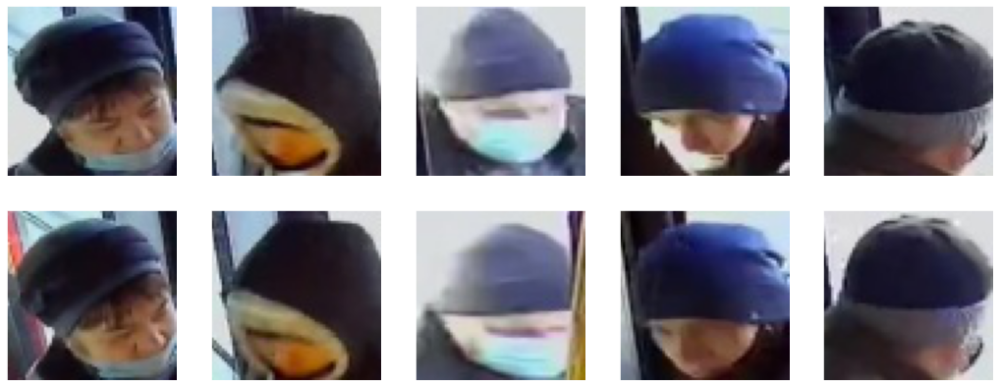

In [ ]:
# Показываем примеры из базы
терра_ии.показать_примеры(
    база = 'Трекер', 
    тип_изображений = 'Один человек'
)

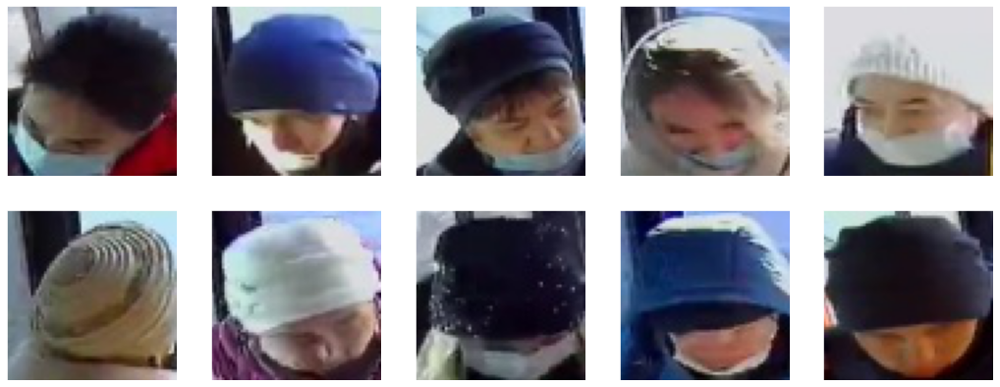

In [ ]:
# Показываем примеры из базы
терра_ии.показать_примеры(
    база = 'Трекер', 
    тип_изображений = 'Разные люди'
)

In [ ]:
# Создаем обучающую и проверочную выборки
(обучающая_выборка, метки_обучающей_выборки), (тестовая_выборка, метки_тестовой_выборки) = терра_ии.создать_выборки_трекер(путь='/Трекер', размер = (64, 64))

Размер сформированного массива обучающая_выборка: (1600, 64, 64, 6)
Размер сформированного массива метки_обучающей_выборки: (1600,)
Размер сформированного массива тестовая_выборка: (400, 64, 64, 6)
Размер сформированного массива метки_тестовой_выборки: (400,)


In [ ]:
# Указываем слои создаваемой модели
слои = 'Сверточный2D-32-3\
 Сверточный2D-32-3\
 Выравнивающий\
 Полносвязный-128\
 Полносвязный-2' # Указываем слои создаваемой модели

# Получаем входной размер данных
входной_размер = терра_ии.получить_входной_размер(обучающая_выборка)

# Создаем модель
нейронка_трекер_1 = терра_ии.создать_сеть(
    слои = слои,
    входной_размер = входной_размер,
    задача='классификация изображений'
    )

Создана модель нейронной сети!


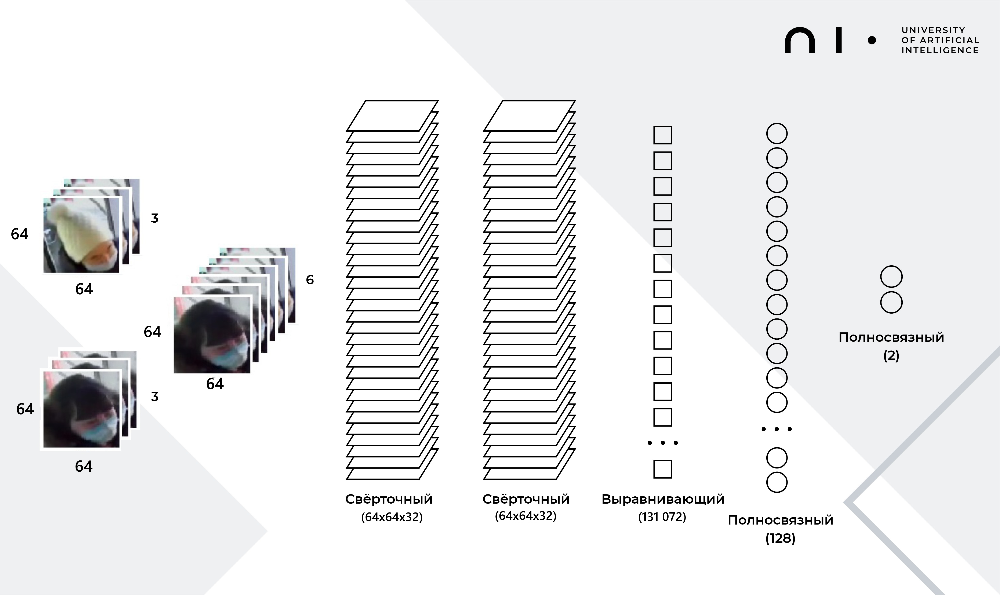

Схема модели:


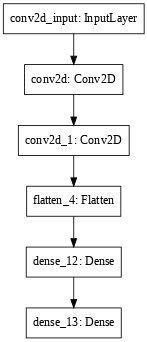

In [ ]:
# Выводим структуру модели
терра_ии.схема_модели(нейронка_трекер_1)

Эпоха №1    Время обучения: 30.43c  Точность на обучающей выборке: 81.12%    Точность на проверочной выборке: 93.0%
Эпоха №2    Время обучения: 1.05c   Точность на обучающей выборке: 94.56%    Точность на проверочной выборке: 95.0%
Эпоха №3    Время обучения: 2.02c   Точность на обучающей выборке: 96.63%    Точность на проверочной выборке: 95.0%
Эпоха №4    Время обучения: 0.95c   Точность на обучающей выборке: 97.81%    Точность на проверочной выборке: 94.75%
Эпоха №5    Время обучения: 1.06c   Точность на обучающей выборке: 98.44%    Точность на проверочной выборке: 96.0%
Эпоха №6    Время обучения: 0.94c   Точность на обучающей выборке: 98.44%    Точность на проверочной выборке: 94.25%
Эпоха №7    Время обучения: 0.95c   Точность на обучающей выборке: 99.31%    Точность на проверочной выборке: 94.0%
Эпоха №8    Время обучения: 0.94c   Точность на обучающей выборке: 99.06%    Точность на проверочной выборке: 95.0%
Эпоха №9    Время обучения: 0.94c   Точность на обучающей выборке: 99.

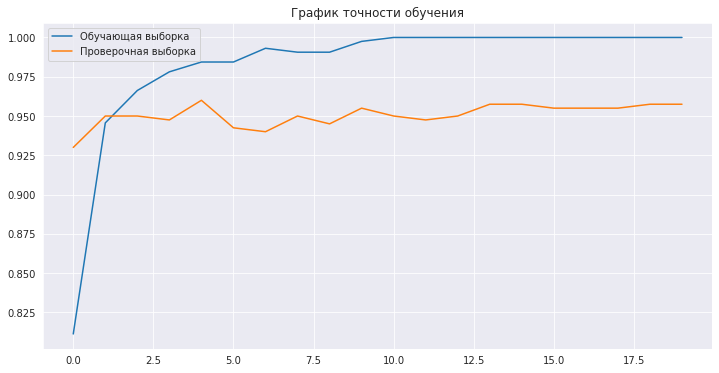

In [ ]:
# Обучаем модель
эксперимент_1 = терра_ии.обучение_модели(
    нейронка_трекер_1,
    обучающая_выборка, метки_обучающей_выборки,
    тестовая_выборка, метки_тестовой_выборки,
    размер_пакета = 64,
    количество_эпох = 20)

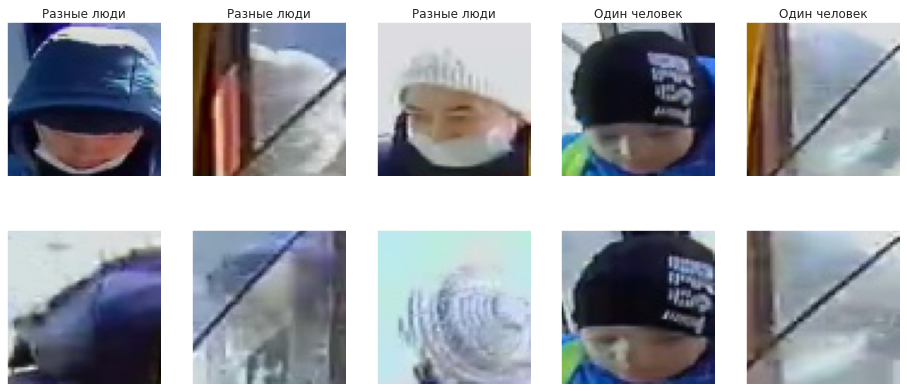

In [ ]:
# Тестируем модель
терра_ии.тест_модели_трекер(
    нейронка_трекер_1,
    тестовый_набор = тестовая_выборка,
    правильные_ответы = метки_тестовой_выборки,
    классы = ['Разные люди', 'Один человек'],
    количество = 5)

Эпоха №1    Время обучения: 14.39c  Точность на обучающей выборке: 63.06%    Точность на проверочной выборке: 77.25%
Эпоха №2    Время обучения: 8.73c   Точность на обучающей выборке: 86.94%    Точность на проверочной выборке: 94.0%
Эпоха №3    Время обучения: 7.07c   Точность на обучающей выборке: 94.19%    Точность на проверочной выборке: 91.75%
Эпоха №4    Время обучения: 7.08c   Точность на обучающей выборке: 94.81%    Точность на проверочной выборке: 95.75%
Эпоха №5    Время обучения: 7.11c   Точность на обучающей выборке: 96.69%    Точность на проверочной выборке: 93.75%
Эпоха №6    Время обучения: 7.11c   Точность на обучающей выборке: 96.31%    Точность на проверочной выборке: 91.75%
Эпоха №7    Время обучения: 7.11c   Точность на обучающей выборке: 96.5%     Точность на проверочной выборке: 95.75%
Эпоха №8    Время обучения: 7.1c    Точность на обучающей выборке: 98.81%    Точность на проверочной выборке: 96.5%
Эпоха №9    Время обучения: 7.15c   Точность на обучающей выборке:

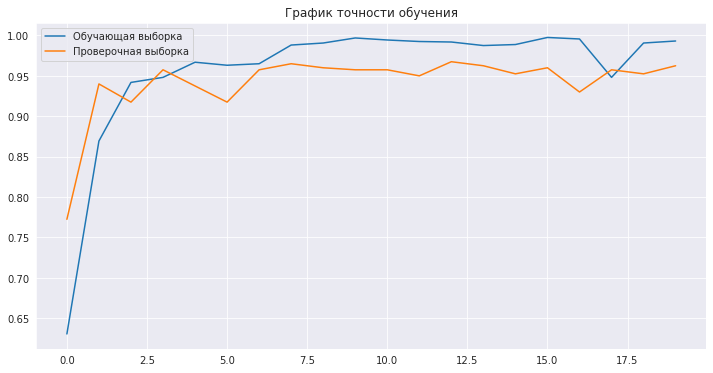

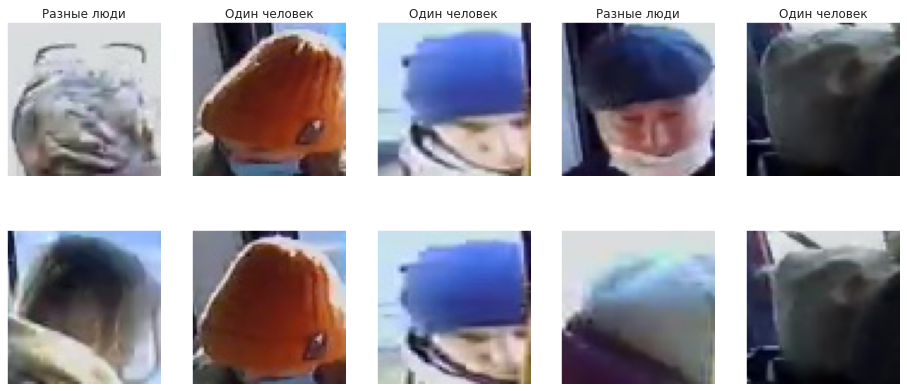

In [ ]:
# Указываем слои создаваемой модели
слои = 'Сверточный2D-32-3\
 Сверточный2D-32-3\
 Сверточный2D-64-3\
 Сверточный2D-64-3\
 Сверточный2D-128-3\
 Сверточный2D-128-3\
 Выравнивающий\
 Полносвязный-256\
 Полносвязный-256\
 Полносвязный-2' # Указываем слои создаваемой модели

# Получаем входной размер данных
входной_размер = терра_ии.получить_входной_размер(обучающая_выборка)

# Создаем модель
нейронка_трекер_2 = терра_ии.создать_сеть(
    слои = слои,
    входной_размер = входной_размер,
    задача='классификация изображений'
    )

# Обучаем модель
эксперимент_2 = терра_ии.обучение_модели(
    нейронка_трекер_2,
    обучающая_выборка, метки_обучающей_выборки,
    тестовая_выборка, метки_тестовой_выборки,
    размер_пакета = 64,
    количество_эпох = 20)

# Тестируем модель
терра_ии.тест_модели_трекер(
    нейронка_трекер_2,
    тестовый_набор = тестовая_выборка,
    правильные_ответы = метки_тестовой_выборки,
    классы = ['Разные люди', 'Один человек'],
    количество = 5)

## Трейдинг с помощью нейронных сетей на базах компаний Яндекс, Газпром и полиметаллах.


In [ ]:
# Загружаем базу 'ТРЕЙДИНГ'
терра_ии.загрузить_базу('ТРЕЙДИНГ', 
                    справка = 'Показать')

Загрузка данных завершена 

url: https://storage.googleapis.com/terra_ai/DataSets/shares.zip
Загружены базы акций трех вариантов: полиметаллы, газпром и яндекс



### Полиметаллы на 1 день вперед, 10 дней

In [ ]:
# Формируем обучающую и проверочную выборки
количество_анализируемых_дней = 10
период_предсказания = 1
(обучающая_выборка, метки_обучающей_выборки), (тестовая_выборка, метки_тестовой_выборки), данные  = терра_ии.создать_выборки_для_торговли(
    акции= 'Полиметаллы',
    количество_анализируемых_дней=количество_анализируемых_дней,
    период_предсказания=период_предсказания)

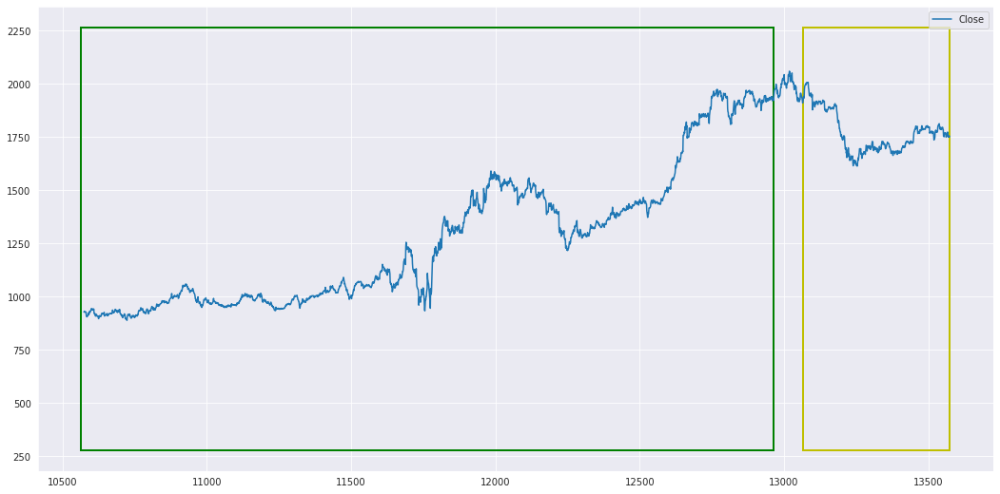

In [ ]:
# показываем пример графика закрытия акций
терра_ии.показать_примеры_для_трейдинга(данные)

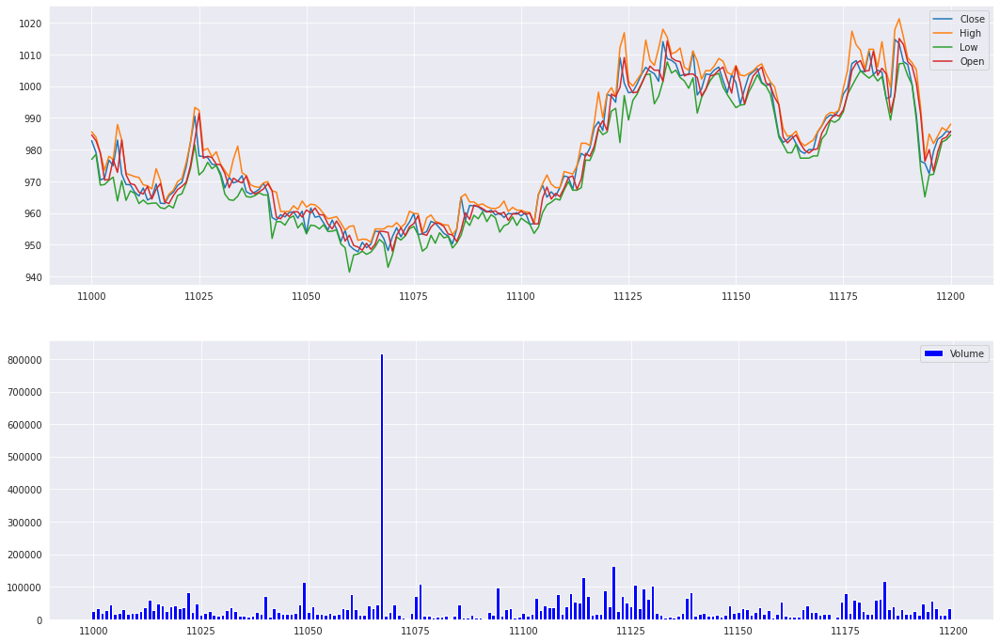

In [ ]:
терра_ии.показать_примеры_для_интервала(данные, 11000, 11200) # Указываем промежуток, где первое число начало интервала, а второе число - окончание 

In [ ]:
# Указываем слои создаваемой модели
слои = 'Выравнивающий Полносвязный-700 Полносвязный-3'

# Получаем входной размер данных
входной_размер = терра_ии.получить_входной_размер(обучающая_выборка)

# Создаем модель
нейронка_трейдинг_1 = терра_ии.создать_сеть(
    слои = слои,
    входной_размер = входной_размер,
    задача = 'временной ряд'
    )

Создана модель нейронной сети!


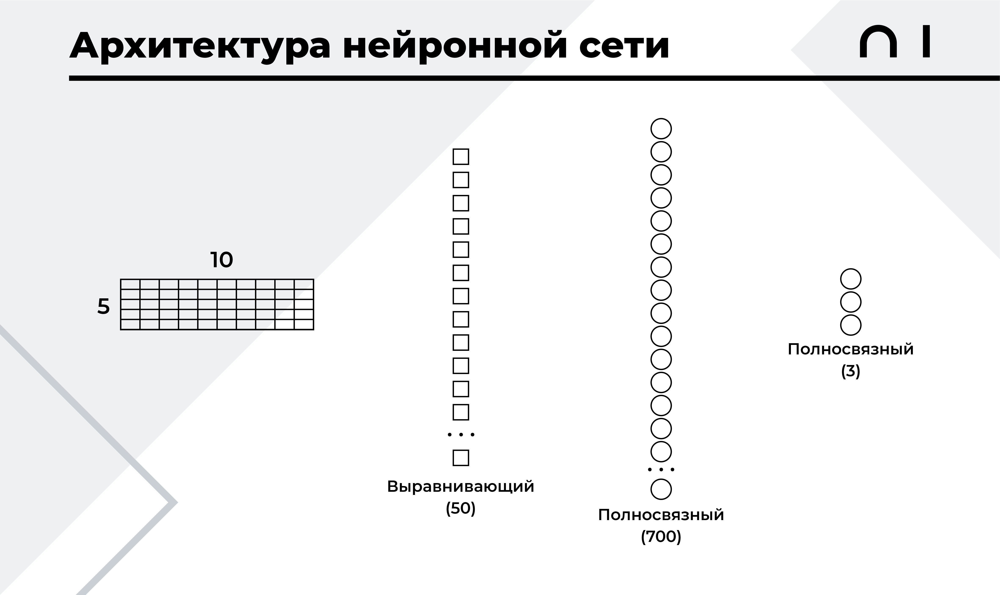

Схема модели:


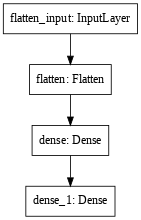

In [ ]:
# Выводим структуру модели
терра_ии.схема_модели(нейронка_трейдинг_1)

Эпоха №1    Время обучения: 0.73c   Точность на обучающей выборке: 62.18%    Точность на проверочной выборке: 64.58%
Эпоха №2    Время обучения: 0.14c   Точность на обучающей выборке: 71.38%    Точность на проверочной выборке: 66.95%
Эпоха №3    Время обучения: 0.13c   Точность на обучающей выборке: 74.31%    Точность на проверочной выборке: 62.2%
Эпоха №4    Время обучения: 0.14c   Точность на обучающей выборке: 80.08%    Точность на проверочной выборке: 60.68%
Эпоха №5    Время обучения: 0.14c   Точность на обучающей выборке: 78.03%    Точность на проверочной выборке: 73.22%
Эпоха №6    Время обучения: 0.13c   Точность на обучающей выборке: 81.17%    Точность на проверочной выборке: 76.27%
Эпоха №7    Время обучения: 0.12c   Точность на обучающей выборке: 81.8%     Точность на проверочной выборке: 71.86%
Эпоха №8    Время обучения: 0.13c   Точность на обучающей выборке: 79.29%    Точность на проверочной выборке: 72.71%
Эпоха №9    Время обучения: 0.15c   Точность на обучающей выборке

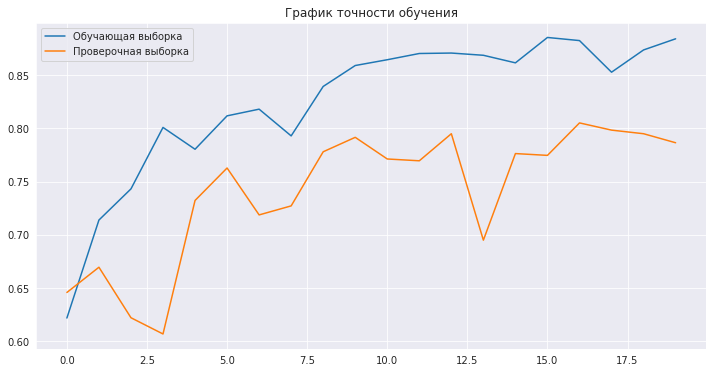

In [ ]:
# Обучаем модель
эксперимент_1 = терра_ии.обучение_модели(
    нейронка_трейдинг_1,
    обучающая_выборка, метки_обучающей_выборки,
    тестовая_выборка, метки_тестовой_выборки,
    размер_пакета = 64,
    количество_эпох = 20)

In [ ]:
# Тестируем модель
терра_ии.тест_модели_торговли(
    нейронка_трейдинг_1, 
    тестовая_выборка, метки_тестовой_выборки,
    данные,
    период_предсказания,
    количество_анализируемых_дней)


Результат теста:
  * Количество отсчетов: 590
  * Правильных предсказаний: 475
  * Ошибочных предсказаний:  115

  * Точность предсказаний: 80.51%


Примеры распознавания

________________________________________
Тест №1
Модель предсказала: падающий тренд
Правильный ответ:  падающий тренд
Текущая цена:  2035.5
Цена через 1 интервал(а): 2009.9


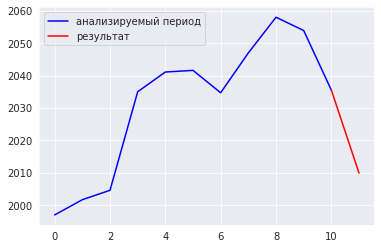

________________________________________
Тест №2
Модель предсказала: нейтральный тренд
Правильный ответ:  нейтральный тренд
Текущая цена:  2031.5
Цена через 1 интервал(а): 2034.7


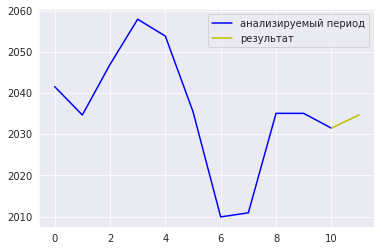

________________________________________
Тест №3
Модель предсказала: нейтральный тренд
Правильный ответ:  нейтральный тренд
Текущая цена:  2034.7
Цена через 1 интервал(а): 2030.2


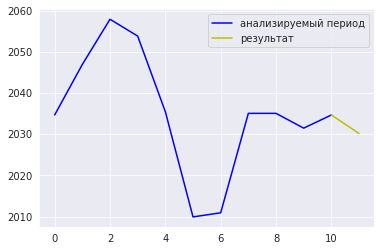

________________________________________
Тест №4
Модель предсказала: падающий тренд
Правильный ответ:  падающий тренд
Текущая цена:  2002.0
Цена через 1 интервал(а): 1978.5


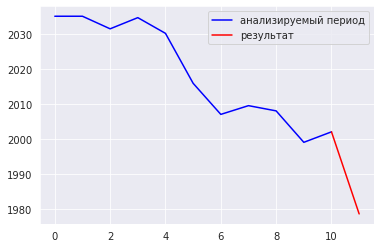

In [ ]:
терра_ии.примеры_распознавания(
          нейронка_трейдинг_1, 
          период_предсказания, 
          количество_анализируемых_дней)

Стартовый капитал: 100000
Прирост после торгов: + 48732
Итого: 148732


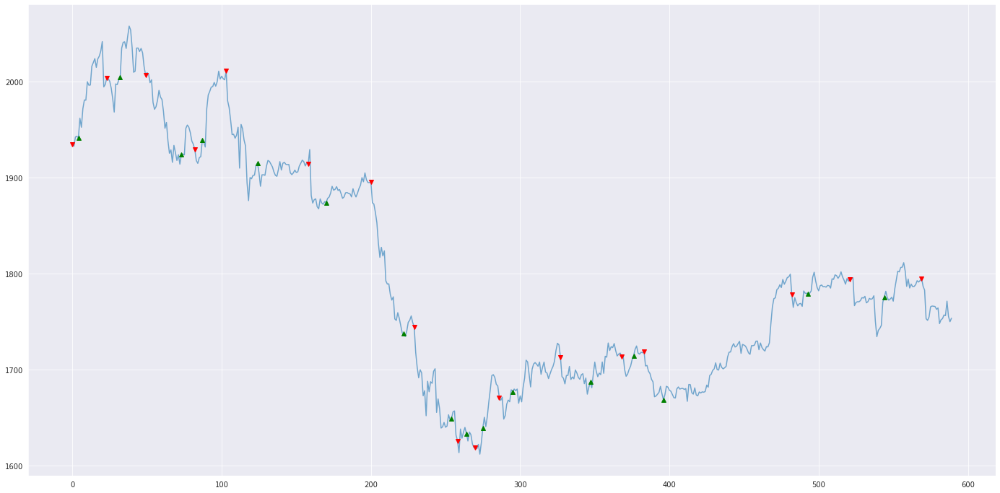

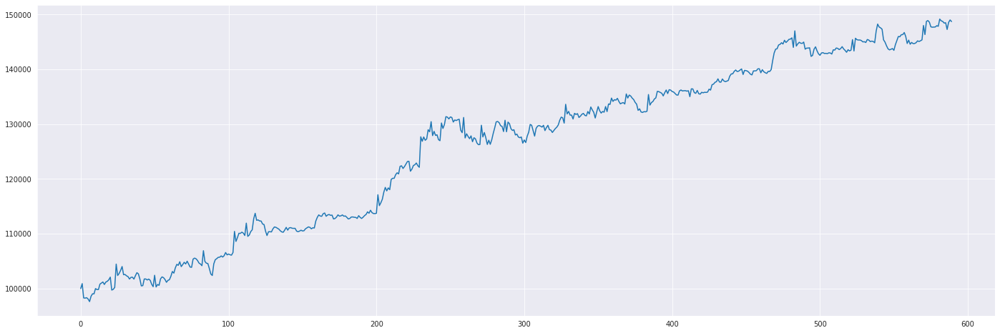

In [ ]:
# для мгновенного вывода результата указываем значение параметра тип='результат'
терра_ии.торговля(нейронка_трейдинг_1, тестовая_выборка, данные, тип='результат')

**Проводим серию экспериментов**

Первый эксперимент

Модель: Выравнивающий + Полносвязный слои

Эпоха №1    Время обучения: 0.64c   Точность на обучающей выборке: 53.89%    Точность на проверочной выборке: 58.64%
Эпоха №2    Время обучения: 0.14c   Точность на обучающей выборке: 67.32%    Точность на проверочной выборке: 70.17%
Эпоха №3    Время обучения: 0.14c   Точность на обучающей выборке: 74.94%    Точность на проверочной выборке: 71.02%
Эпоха №4    Время обучения: 0.13c   Точность на обучающей выборке: 77.74%    Точность на проверочной выборке: 73.05%
Эпоха №5    Время обучения: 0.13c   Точность на обучающей выборке: 79.46%    Точность на проверочной выборке: 71.36%
Эпоха №6    Время обучения: 0.13c   Точность на обучающей выборке: 79.75%    Точность на проверочной выборке: 63.22%
Эпоха №7    Время обучения: 0.15c   Точность на обучающей выборке: 82.43%    Точность на проверочной выборке: 78.14%
Эпоха №8    Время обучения: 0.12c   Точность на обучающей выборке: 86.82%    Точность на проверочной выборке: 79.15%
Эпоха №9    Время обучения: 0.15c   Точность на обучающей выборк

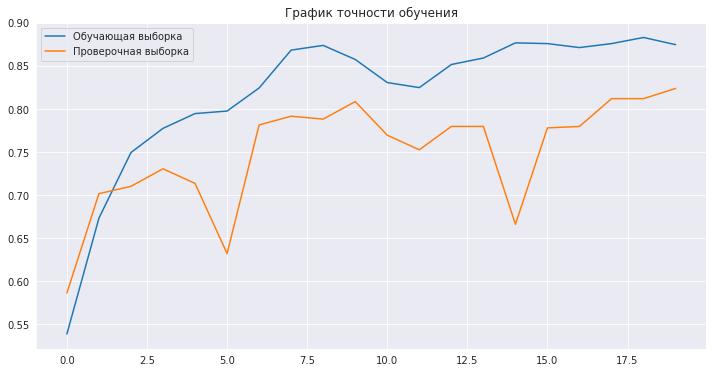

Стартовый капитал: 100000
Прирост после торгов: + 65258
Итого: 165258


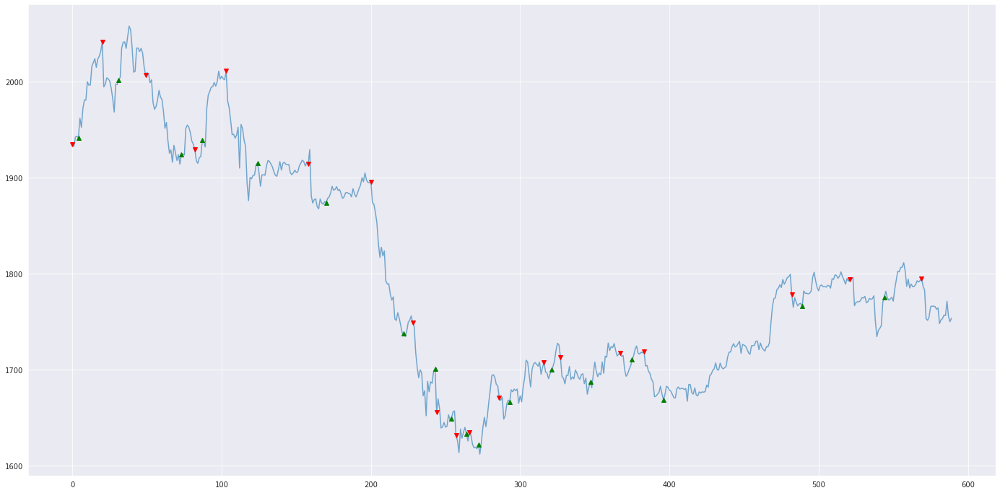

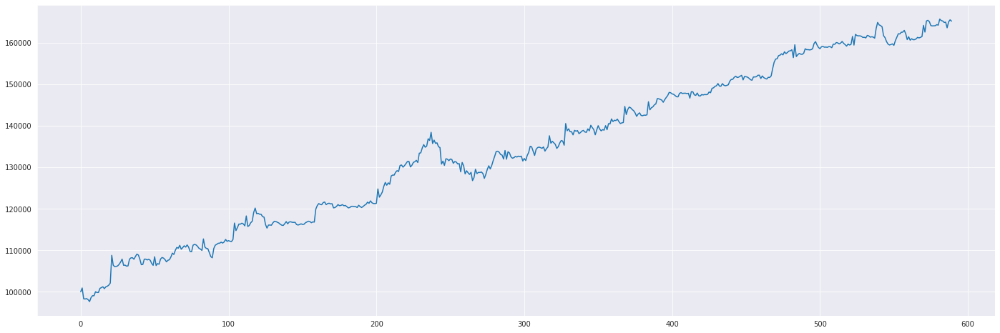

In [ ]:
# Указываем слои создаваемой модели
слои = 'Выравнивающий Полносвязный-2000 Полносвязный-3'

входной_размер = терра_ии.получить_входной_размер(обучающая_выборка)

# Создаем модель
нейронка_трейдинг_2 = терра_ии.создать_сеть(
    слои = слои,
    входной_размер = входной_размер,
    задача = 'временной ряд'
    )

# Обучаем модель
эксперимент_2 = терра_ии.обучение_модели(
    нейронка_трейдинг_2,
    обучающая_выборка, метки_обучающей_выборки,
    тестовая_выборка, метки_тестовой_выборки,
    размер_пакета = 64,
    количество_эпох = 20)

# для мгновенного вывода результата указываем значение параметра тип='результат'
терра_ии.торговля(нейронка_трейдинг_2, тестовая_выборка, данные, тип='результат')

Второй эксперимент

Модель: выравнивающий + несколько полносвязных слоев

Запуск №1   Время обучения: 6.55c Точность на обучающей выборке: 83.26%      Точность на проверочной выборке: 83.39%
Запуск №2   Время обучения: 7.94c Точность на обучающей выборке: 84.18%      Точность на проверочной выборке: 83.22%
Запуск №3   Время обучения: 6.04c Точность на обучающей выборке: 88.33%      Точность на проверочной выборке: 82.03%
Запуск №4   Время обучения: 6.52c Точность на обучающей выборке: 91.88%      Точность на проверочной выборке: 81.36%
Запуск №5   Время обучения: 5.08c Точность на обучающей выборке: 94.77%      Точность на проверочной выборке: 82.54%
Запуск №6   Время обучения: 40.03cТочность на обучающей выборке: 94.02%      Точность на проверочной выборке: 81.69%
Запуск №7   Время обучения: 5.43c Точность на обучающей выборке: 98.79%      Точность на проверочной выборке: 81.36%
Запуск №8   Время обучения: 12.25cТочность на обучающей выборке: 96.99%      Точность на проверочной выборке: 81.69%
Запуск №9   Время обучения: 5.27c Точность на обучающей выборке:

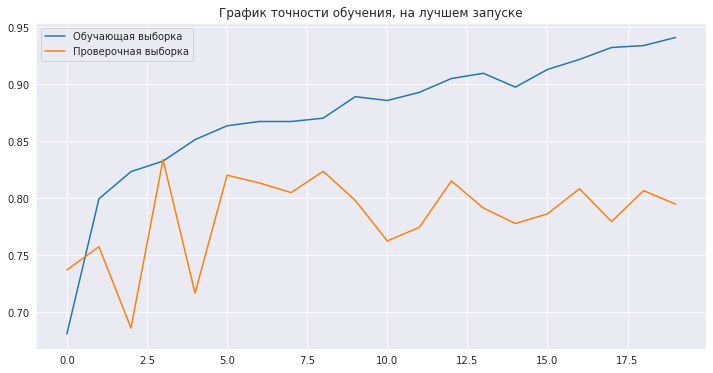

Стартовый капитал: 100000
Прирост после торгов: + 81660
Итого: 181660


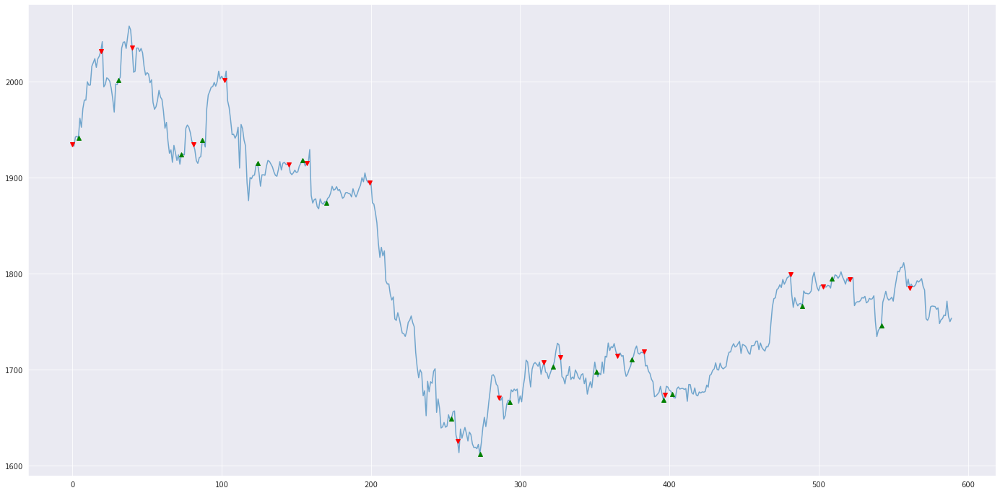

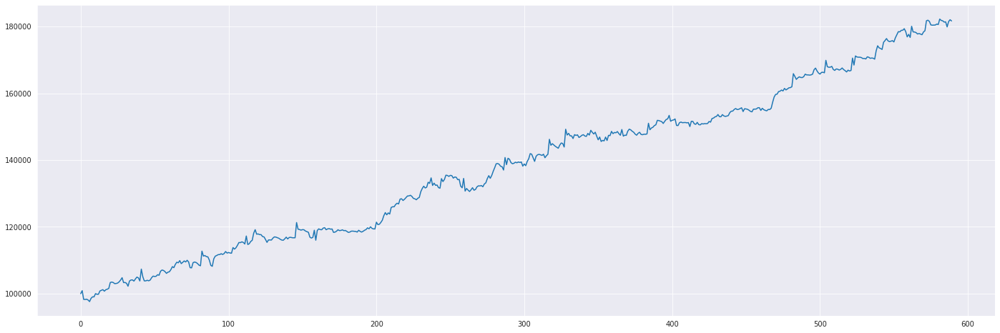

In [ ]:
# Указываем слои создаваемой модели
слои = 'Выравнивающий Полносвязный-2000 Полносвязный-1500 Полносвязный-1000 Полносвязный-500 Полносвязный-250 Полносвязный-3'

входной_размер = терра_ии.получить_входной_размер(обучающая_выборка)

# Создаем модель
нейронка_трейдинг_3 = терра_ии.создать_сеть(
    слои = слои,
    входной_размер = входной_размер,
    задача = 'временной ряд'
    )

# Обучаем модель
эксперимент_3 = терра_ии.обучение_модели(
    нейронка_трейдинг_3,
    обучающая_выборка, метки_обучающей_выборки,
    тестовая_выборка, метки_тестовой_выборки,
    размер_пакета = 64,
    количество_эпох = 20, 
    количество_запусков = 10)

# для мгновенного вывода результата указываем значение параметра тип='результат'
терра_ии.торговля(нейронка_трейдинг_3, тестовая_выборка, данные, тип='результат')

Третий эксперимент

Модель: сложная сеть из нескольких сверточных, выравнивающего и полносвязного слоёв

In [ ]:
# Указываем слои создаваемой модели
слои = 'Сверточный1D-16-5\
 Сверточный1D-32-5\
 Выравнивающий Полносвязный-512 Полносвязный-3'

входной_размер = терра_ии.получить_входной_размер(обучающая_выборка)

# Создаем модель
нейронка_трейдинг_4 = терра_ии.создать_сеть(
    слои = слои,
    входной_размер = входной_размер,
    задача = 'временной ряд'
    )

Создана модель нейронной сети!


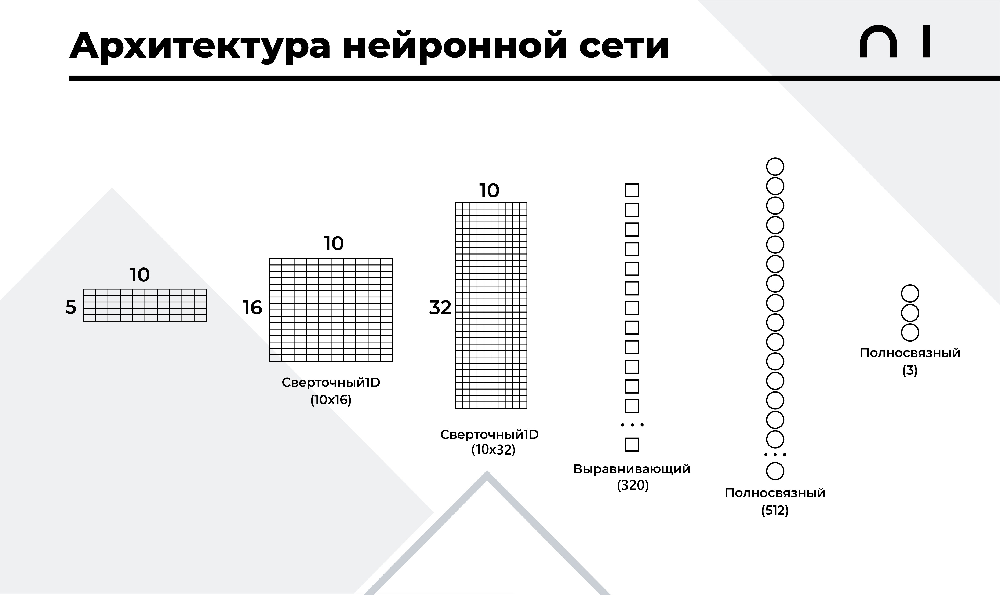

Эпоха №1    Время обучения: 1.36c   Точность на обучающей выборке: 70.13%    Точность на проверочной выборке: 73.73%
Эпоха №2    Время обучения: 0.63c   Точность на обучающей выборке: 80.96%    Точность на проверочной выборке: 81.86%
Эпоха №3    Время обучения: 0.55c   Точность на обучающей выборке: 82.93%    Точность на проверочной выборке: 81.69%
Эпоха №4    Время обучения: 0.64c   Точность на обучающей выборке: 84.9%     Точность на проверочной выборке: 81.53%
Эпоха №5    Время обучения: 0.61c   Точность на обучающей выборке: 87.49%    Точность на проверочной выборке: 81.02%
Эпоха №6    Время обучения: 0.63c   Точность на обучающей выборке: 88.83%    Точность на проверочной выборке: 80.34%
Эпоха №7    Время обучения: 0.56c   Точность на обучающей выборке: 90.84%    Точность на проверочной выборке: 82.2%
Эпоха №8    Время обучения: 0.64c   Точность на обучающей выборке: 92.51%    Точность на проверочной выборке: 81.02%
Эпоха №9    Время обучения: 0.62c   Точность на обучающей выборке

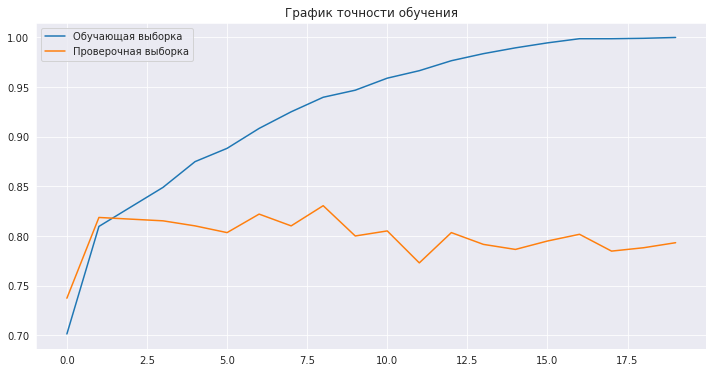

In [ ]:
# Обучаем модель
эксперимент_4 = терра_ии.обучение_модели(
    нейронка_трейдинг_4,
    обучающая_выборка, метки_обучающей_выборки,
    тестовая_выборка, метки_тестовой_выборки,
    размер_пакета = 16,
    количество_эпох = 20)

In [ ]:
# Тестируем модель
терра_ии.тест_модели_торговли(
    нейронка_трейдинг_4, 
    тестовая_выборка, метки_тестовой_выборки,
    данные,
    период_предсказания,
    количество_анализируемых_дней)


Результат теста:
  * Количество отсчетов: 590
  * Правильных предсказаний: 485
  * Ошибочных предсказаний:  105

  * Точность предсказаний: 82.2%


Примеры распознавания

________________________________________
Тест №1
Модель предсказала: нейтральный тренд
Правильный ответ:  нейтральный тренд
Текущая цена:  2035.1
Цена через 1 интервал(а): 2035.1


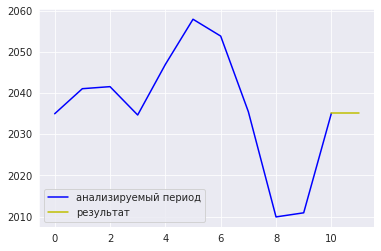

________________________________________
Тест №2
Модель предсказала: нейтральный тренд
Правильный ответ:  нейтральный тренд
Текущая цена:  2031.5
Цена через 1 интервал(а): 2034.7


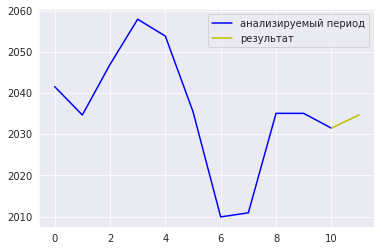

________________________________________
Тест №3
Модель предсказала: падающий тренд
Правильный ответ:  падающий тренд
Текущая цена:  1969.0
Цена через 1 интервал(а): 1951.5


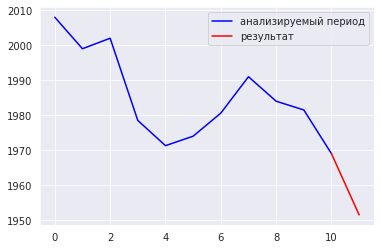

________________________________________
Тест №4
Модель предсказала: растущий тренд
Правильный ответ:  растущий тренд
Текущая цена:  1923.8
Цена через 1  интервал(а): 1951.5


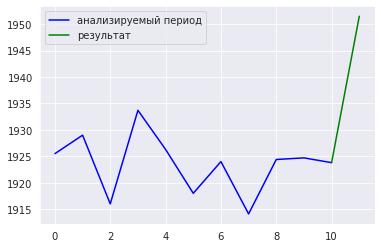

Стартовый капитал: 100000
Прирост после торгов: + 89025
Итого: 189025


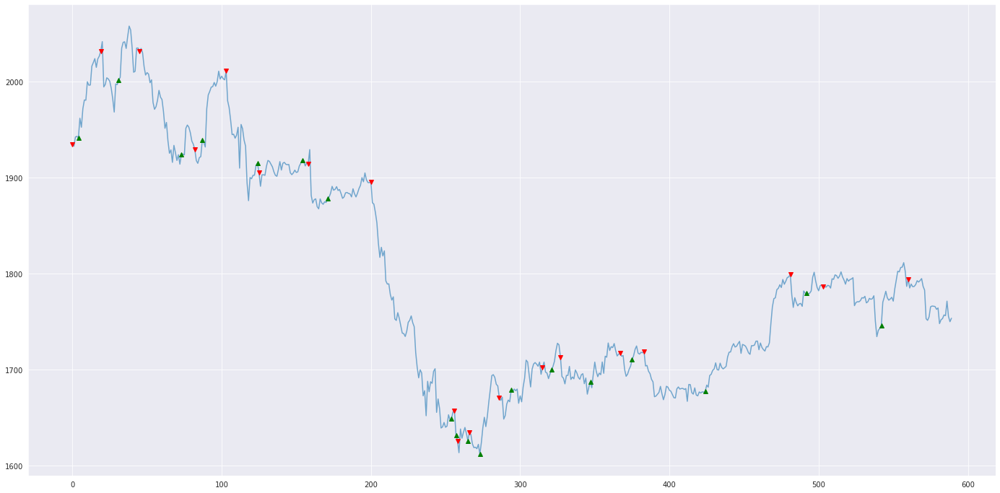

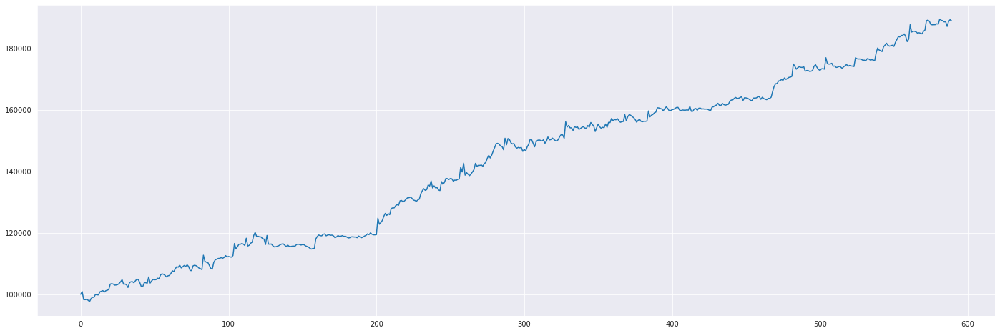

In [ ]:
терра_ии.примеры_распознавания(
          нейронка_трейдинг_4, 
          период_предсказания, 
          количество_анализируемых_дней)

# для мгновенного вывода результата указываем значение параметра тип='результат'
терра_ии.торговля(нейронка_трейдинг_4, тестовая_выборка, данные, тип='результат')

## Сегментация изображений (самолеты, люди).


### Сегментация самолетов

In [ ]:
# Загружаем базу самолетов
изображения, сегментированные_изображения = терра_ии.загрузить_базу(
    база = 'САМОЛЕТЫ',
    справка = 'Показать'
)

Загрузка данных завершена 

url: https://storage.googleapis.com/terra_ai/DataSets/segment.zip
Вы скачали базу самолетов. 
База состоит из оригинальных изображений и соовтетствующих им размеченных сегментированных изображений.
Количество изображений в базе: 981


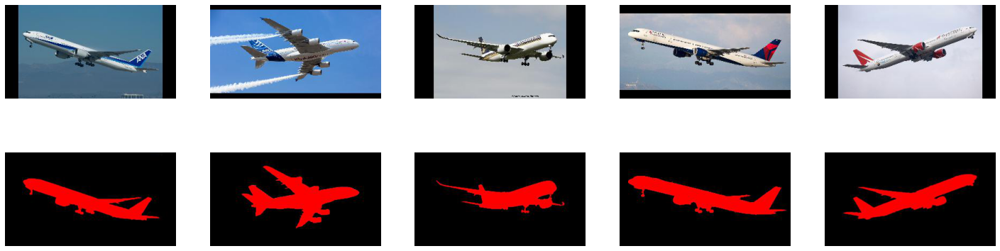

In [ ]:
# Отображаем примеры изображений из базы
терра_ии.показать_примеры(
    оригиналы = изображения,
    сегментированные_изображения = сегментированные_изображения
)

In [ ]:
# Формируем данные для обучения
(обучающая_выборка, размеченная_обучающая_выборка), (тестовая_выборка, размеченная_тестовая_выборка) = терра_ии.создать_выборки_для_сегментации(
    изображения, 
    сегментированные_изображения
)


Данные загружены. Обработано: 981 изображений
Время обработки:  772.88 c


#### Исследования

#### Эксперимент № 1.1 
Модель: простая линейная сеть

In [ ]:
# Указываем слои создаваемой модели
слои = 'Сверточный2D-32-3\
 Сверточный2D-32-3\
 Сверточный2D-2-3' 

# Получаем входной размер данных
входной_размер = терра_ии.получить_входной_размер(обучающая_выборка)

# Создаем модель
нейронка_самолеты_1 = терра_ии.создать_сеть(
    слои = слои,
    входной_размер = входной_размер,
    задача='сегментация изображений'
    )

Создана модель нейронной сети!


Схема модели:


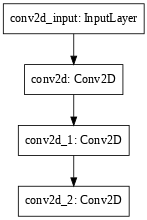

In [ ]:
# Выводим структуру модели
терра_ии.схема_модели(нейронка_самолеты_1)

Эпоха №1    Время обучения: 5.59c   Точность на обучающей выборке: 69.94%    Точность на проверочной выборке: 77.13%
Эпоха №2    Время обучения: 0.98c   Точность на обучающей выборке: 72.92%    Точность на проверочной выборке: 79.37%
Эпоха №3    Время обучения: 0.98c   Точность на обучающей выборке: 77.58%    Точность на проверочной выборке: 80.31%
Эпоха №4    Время обучения: 0.98c   Точность на обучающей выборке: 81.72%    Точность на проверочной выборке: 80.57%
Эпоха №5    Время обучения: 0.99c   Точность на обучающей выборке: 82.56%    Точность на проверочной выборке: 83.73%
Эпоха №6    Время обучения: 0.98c   Точность на обучающей выборке: 84.53%    Точность на проверочной выборке: 85.77%
Эпоха №7    Время обучения: 0.97c   Точность на обучающей выборке: 87.26%    Точность на проверочной выборке: 87.16%
Эпоха №8    Время обучения: 0.97c   Точность на обучающей выборке: 88.18%    Точность на проверочной выборке: 88.87%
Эпоха №9    Время обучения: 0.98c   Точность на обучающей выборк

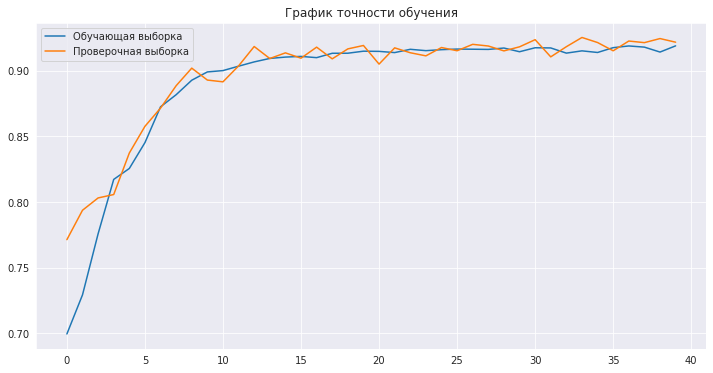

In [ ]:
# Обучаем модель
эксперимент_1_1 = терра_ии.обучение_модели(
    нейронка_самолеты_1,
    обучающая_выборка, размеченная_обучающая_выборка,
    тестовая_выборка, размеченная_тестовая_выборка,
    размер_пакета = 64,
    количество_эпох = 40)

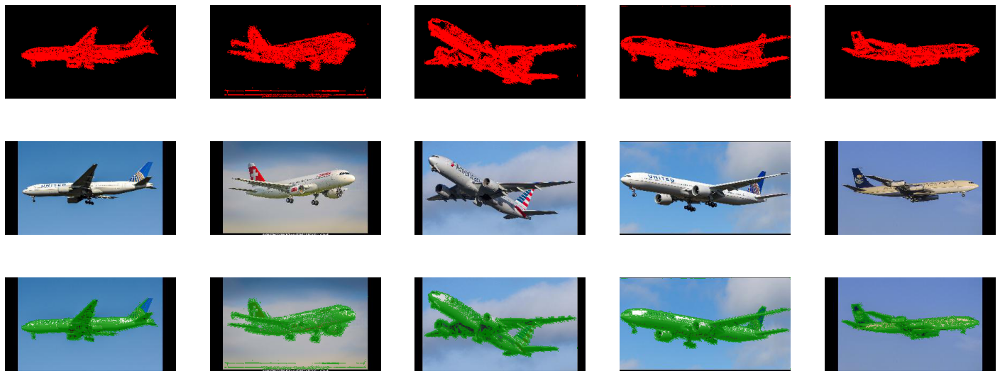

In [ ]:
# Тестируем работу модели
терра_ии.тест_модели_сегментации(
    нейронка_самолеты_1,
    тестовые_изображения = тестовая_выборка
)

#### Эксперимент № 2.1
Модель: PSP-NET





In [ ]:
# Указываем слои создаваемой модели
стартовый_блок = 'Сверточный2D-32-3\
 Сверточный2D-32-3'

блок_PSP = 'Сверточный2D-32-3'

финальный_блок = 'Сверточный2D-32-3\
 Сверточный2D-32-3\
 Сверточный2D-2-3'

# Получаем входной размер данных
входной_размер = терра_ии.получить_входной_размер(обучающая_выборка)

# Создаем модель
нейронка_самолеты_2 = терра_ии.создать_PSP(
    стартовый_блок = стартовый_блок,
    блок_PSP = блок_PSP, 
    финальный_блок = финальный_блок,    
    входной_размер = входной_размер,
    количество_блоков = 2
)

Создана модель нейронной сети!


Схема модели:


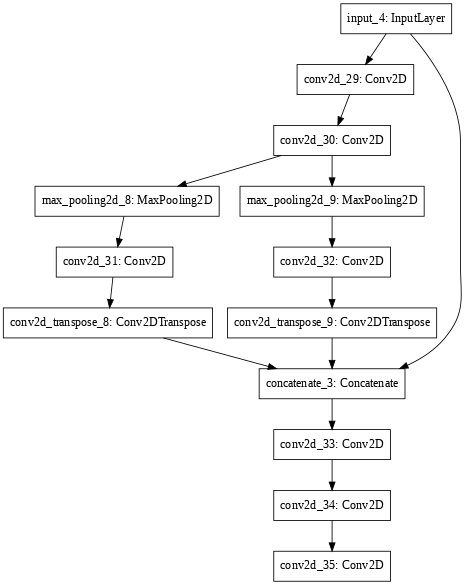

In [ ]:
# Выводим структуру модели
терра_ии.схема_модели(нейронка_самолеты_2)

Эпоха №1    Время обучения: 4.33c   Точность на обучающей выборке: 82.75%    Точность на проверочной выборке: 88.26%
Эпоха №2    Время обучения: 2.67c   Точность на обучающей выборке: 91.77%    Точность на проверочной выборке: 92.96%
Эпоха №3    Время обучения: 2.67c   Точность на обучающей выборке: 93.14%    Точность на проверочной выборке: 93.99%
Эпоха №4    Время обучения: 2.64c   Точность на обучающей выборке: 93.41%    Точность на проверочной выборке: 93.95%
Эпоха №5    Время обучения: 2.66c   Точность на обучающей выборке: 93.68%    Точность на проверочной выборке: 92.42%
Эпоха №6    Время обучения: 2.69c   Точность на обучающей выборке: 93.8%     Точность на проверочной выборке: 94.48%
Эпоха №7    Время обучения: 2.66c   Точность на обучающей выборке: 94.08%    Точность на проверочной выборке: 94.68%
Эпоха №8    Время обучения: 2.68c   Точность на обучающей выборке: 94.15%    Точность на проверочной выборке: 94.54%
Эпоха №9    Время обучения: 2.69c   Точность на обучающей выборк

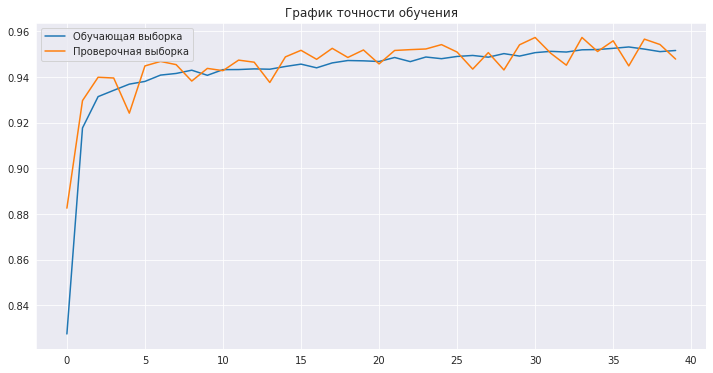

In [ ]:
# Обучаем модель
эксперимент_2_1 = терра_ии.обучение_модели(
    нейронка_самолеты_2,
    обучающая_выборка, размеченная_обучающая_выборка,
    тестовая_выборка, размеченная_тестовая_выборка,
    размер_пакета = 8,
    количество_эпох = 40)

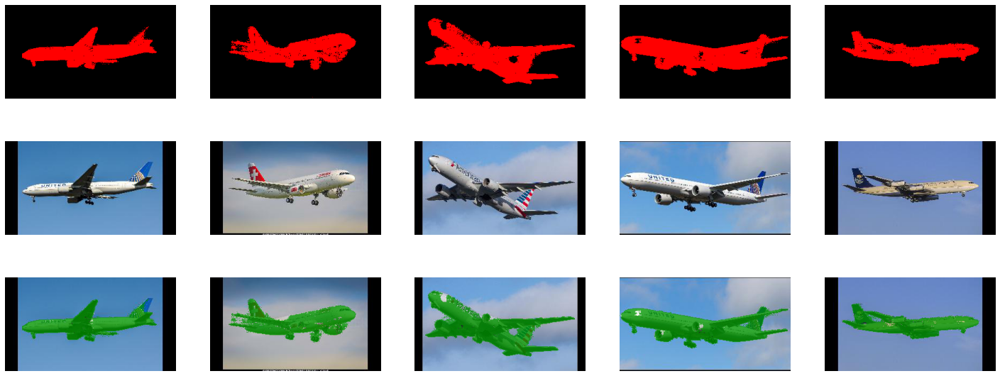

In [ ]:
# Тестируем модель
терра_ии.тест_модели_сегментации(
    нейронка_самолеты_2,
    тестовые_изображения = тестовая_выборка
)

#### Эксперимент № 2.2
Модель: PSP-NET


In [ ]:
# Указываем слои создаваемой модели
стартовый_блок = 'Сверточный2D-64-2\
 Сверточный2D-64-2'

блок_PSP = 'Сверточный2D-64-2'

финальный_блок = 'Сверточный2D-64-2\
 Сверточный2D-64-2\
 Сверточный2D-2-2'

# Указываем размер входных данных
входной_размер = терра_ии.получить_входной_размер(обучающая_выборка)

# Содаем модель
нейронка_самолеты_2_2 = терра_ии.создать_PSP(
    стартовый_блок = стартовый_блок,
    блок_PSP = блок_PSP, 
    финальный_блок = финальный_блок,    
    входной_размер = входной_размер,
    количество_блоков = 4
)

Создана модель нейронной сети!


Схема модели:


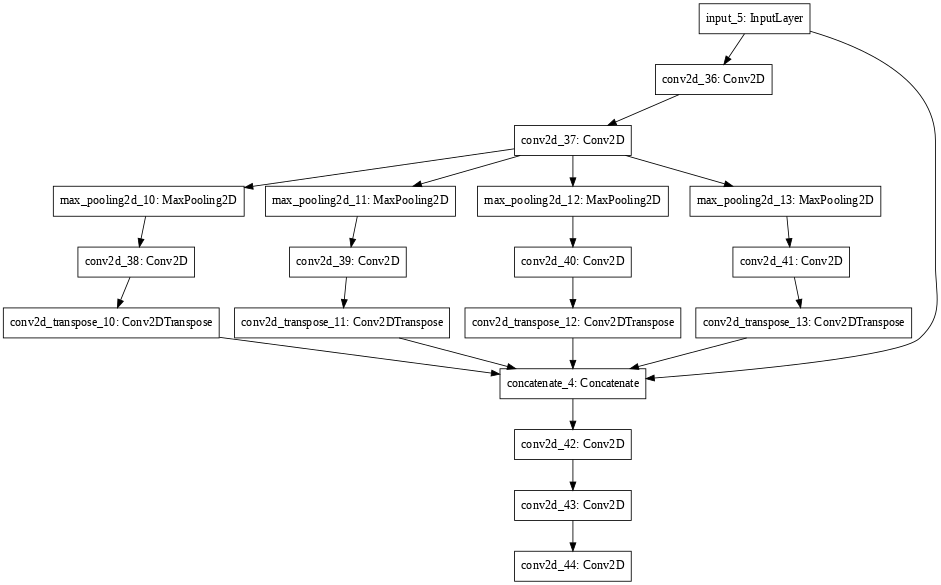

In [ ]:
# Выводим структуру модели
терра_ии.схема_модели(нейронка_самолеты_2_2)

Эпоха №1    Время обучения: 8.34c   Точность на обучающей выборке: 85.06%    Точность на проверочной выборке: 92.03%
Эпоха №2    Время обучения: 6.17c   Точность на обучающей выборке: 93.21%    Точность на проверочной выборке: 91.85%
Эпоха №3    Время обучения: 6.19c   Точность на обучающей выборке: 93.96%    Точность на проверочной выборке: 94.37%
Эпоха №4    Время обучения: 6.2c    Точность на обучающей выборке: 94.61%    Точность на проверочной выборке: 94.98%
Эпоха №5    Время обучения: 6.2c    Точность на обучающей выборке: 94.78%    Точность на проверочной выборке: 95.34%
Эпоха №6    Время обучения: 6.17c   Точность на обучающей выборке: 94.94%    Точность на проверочной выборке: 94.02%
Эпоха №7    Время обучения: 6.2c    Точность на обучающей выборке: 94.86%    Точность на проверочной выборке: 95.37%
Эпоха №8    Время обучения: 6.2c    Точность на обучающей выборке: 95.21%    Точность на проверочной выборке: 95.45%
Эпоха №9    Время обучения: 6.2c    Точность на обучающей выборк

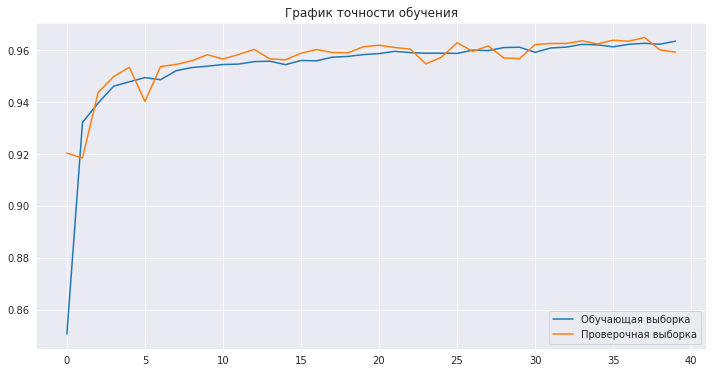

In [ ]:
# Обучаем модель
эксперимент_2_2 = терра_ии.обучение_модели(
    нейронка_самолеты_2_2,
    обучающая_выборка, размеченная_обучающая_выборка,
    тестовая_выборка, размеченная_тестовая_выборка,
    размер_пакета = 8,
    количество_эпох= 40)

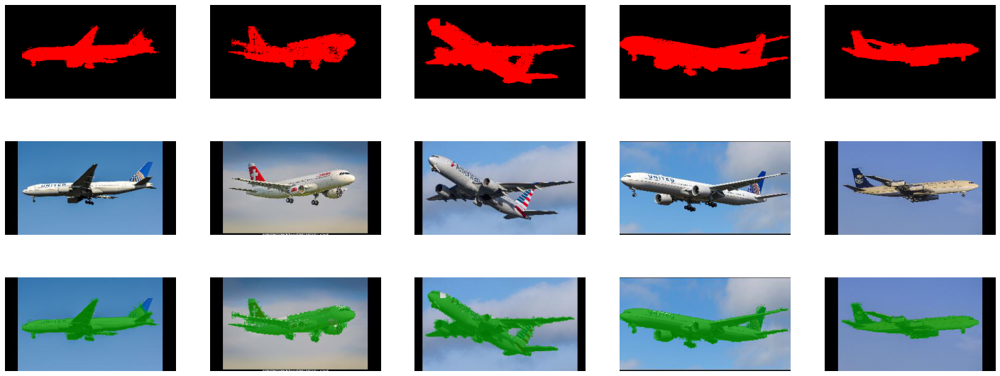

In [ ]:
# Тестируем модель
терра_ии.тест_модели_сегментации(
    нейронка_самолеты_2_2,
    тестовые_изображения = тестовая_выборка
)


#### Эксперимент № 3.1
Модель: U-net

In [ ]:
# Указываем слои для создаваемой модели
блок_вниз_1  =  'Сверточный2D-32-3 Сверточный2D-32-3'
блок_вниз_2  =  'Сверточный2D-64-3 Сверточный2D-64-3'

блок_внизу   =  'Сверточный2D-128-3 Сверточный2D-128-3'

блок_вверх_1 =  'Объединение Сверточный2D-64-3 Сверточный2D-64-3'
блок_вверх_2 =  'Объединение Сверточный2D-32-3 Сверточный2D-32-3'

# Получаем размер входных данных
входной_размер = терра_ии.получить_входной_размер(обучающая_выборка)
# Создаем модель
нейронка_самолеты_3 = терра_ии.создать_UNET(
    блоки_вниз = [блок_вниз_1, блок_вниз_2],
    блок_внизу = блок_внизу, 
    блоки_вверх = [блок_вверх_1, блок_вверх_2],    
    входной_размер = входной_размер)

Создана модель нейронной сети!


Схема модели:


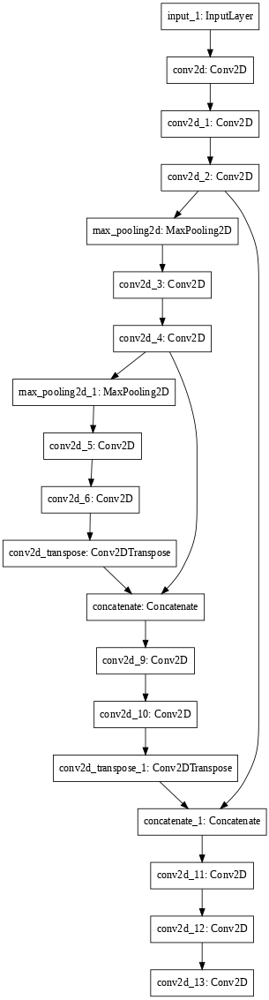

In [ ]:
# Выводим структуру модели
терра_ии.схема_модели(нейронка_самолеты_3)

Эпоха №1    Время обучения: 5.98c   Точность на обучающей выборке: 87.91%    Точность на проверочной выборке: 92.28%
Эпоха №2    Время обучения: 3.72c   Точность на обучающей выборке: 93.39%    Точность на проверочной выборке: 92.79%
Эпоха №3    Время обучения: 3.73c   Точность на обучающей выборке: 88.49%    Точность на проверочной выборке: 92.22%
Эпоха №4    Время обучения: 3.72c   Точность на обучающей выборке: 94.03%    Точность на проверочной выборке: 92.62%
Эпоха №5    Время обучения: 3.89c   Точность на обучающей выборке: 94.59%    Точность на проверочной выборке: 95.22%
Эпоха №6    Время обучения: 3.71c   Точность на обучающей выборке: 95.05%    Точность на проверочной выборке: 95.5%
Эпоха №7    Время обучения: 3.69c   Точность на обучающей выборке: 95.2%     Точность на проверочной выборке: 94.84%
Эпоха №8    Время обучения: 3.69c   Точность на обучающей выборке: 95.18%    Точность на проверочной выборке: 95.78%
Эпоха №9    Время обучения: 3.71c   Точность на обучающей выборке

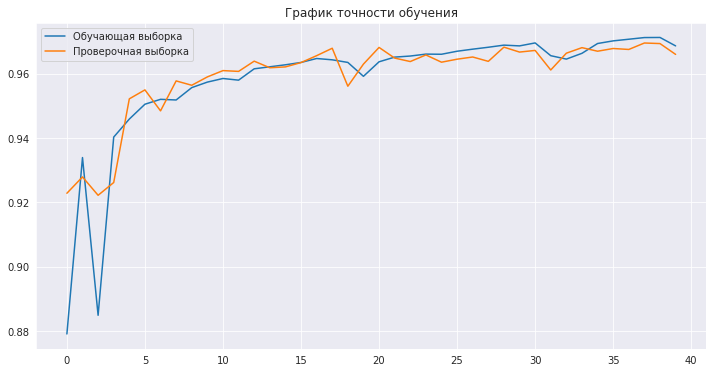

In [ ]:
# Обучаем модель
эксперимент_3_1 = терра_ии.обучение_модели(
    нейронка_самолеты_3,
    обучающая_выборка, размеченная_обучающая_выборка,
    тестовая_выборка, размеченная_тестовая_выборка,
    размер_пакета = 8,
    количество_эпох = 40)

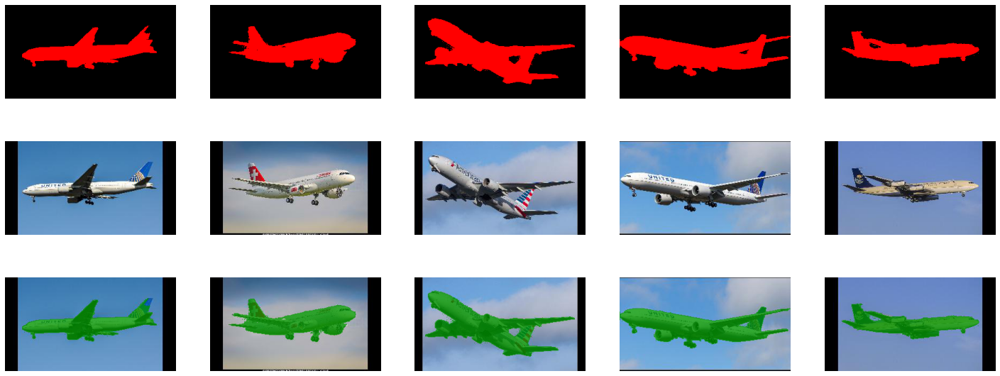

In [ ]:
# Тестируем модель
терра_ии.тест_модели_сегментации(
    нейронка_самолеты_3,
    тестовые_изображения = тестовая_выборка
)

####Эксперимент № 3.2 (лучшая модель)
Модель: U-Net


In [ ]:
# Указываем слои для создаваемой модели
блок_вниз_1  =  'Сверточный2D-32-3 Сверточный2D-32-3'
блок_вниз_2  =  'Сверточный2D-64-3 Сверточный2D-64-3'
блок_вниз_3  =  'Сверточный2D-128-3 Сверточный2D-128-3'

блок_внизу   =  'Сверточный2D-256-3 Сверточный2D-256-3'

блок_вверх_1 =  'Объединение Сверточный2D-128-3 Сверточный2D-128-3'
блок_вверх_2 =  'Объединение Сверточный2D-64-3 Сверточный2D-64-3'
блок_вверх_3 =  'Объединение Сверточный2D-32-3 Сверточный2D-32-3'

# Получаем размер входных данных
входной_размер = терра_ии.получить_входной_размер(обучающая_выборка)
# Создаем модель
нейронка_самолеты_3_2 = терра_ии.создать_UNET(
    блоки_вниз = [блок_вниз_1, блок_вниз_2, блок_вниз_3],
    блок_внизу = блок_внизу, 
    блоки_вверх = [блок_вверх_1, блок_вверх_2, блок_вверх_3],    
    входной_размер = входной_размер)

Создана модель нейронной сети!


Схема модели:


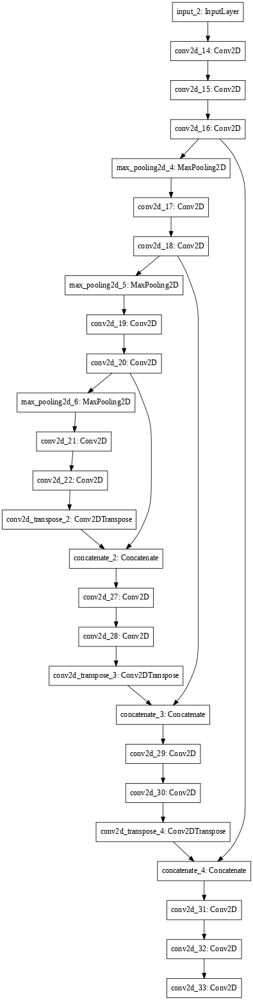

In [ ]:
# Выводим структуру модели
терра_ии.схема_модели(нейронка_самолеты_3_2)

Эпоха №1    Время обучения: 7.85c   Точность на обучающей выборке: 85.18%    Точность на проверочной выборке: 92.05%
Эпоха №2    Время обучения: 5.28c   Точность на обучающей выборке: 93.15%    Точность на проверочной выборке: 94.28%
Эпоха №3    Время обучения: 5.27c   Точность на обучающей выборке: 94.83%    Точность на проверочной выборке: 95.78%
Эпоха №4    Время обучения: 5.22c   Точность на обучающей выборке: 94.79%    Точность на проверочной выборке: 95.13%
Эпоха №5    Время обучения: 5.26c   Точность на обучающей выборке: 94.78%    Точность на проверочной выборке: 95.29%
Эпоха №6    Время обучения: 5.27c   Точность на обучающей выборке: 95.6%     Точность на проверочной выборке: 95.98%
Эпоха №7    Время обучения: 5.27c   Точность на обучающей выборке: 95.92%    Точность на проверочной выборке: 96.06%
Эпоха №8    Время обучения: 5.21c   Точность на обучающей выборке: 96.09%    Точность на проверочной выборке: 96.15%
Эпоха №9    Время обучения: 5.27c   Точность на обучающей выборк

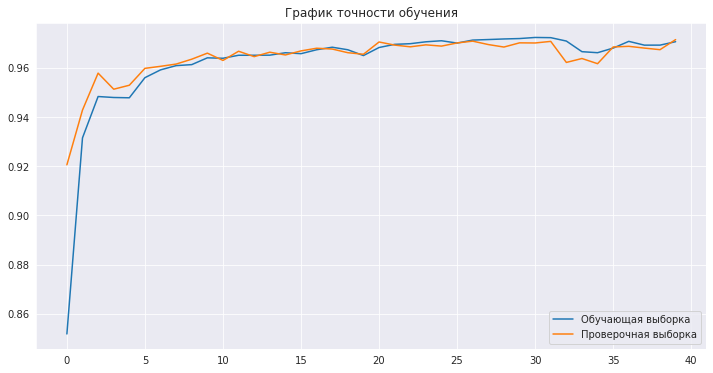

In [ ]:
# Обучаем модель
эксперимент_3_2 = терра_ии.обучение_модели(
    нейронка_самолеты_3_2,
    обучающая_выборка, размеченная_обучающая_выборка,
    тестовая_выборка, размеченная_тестовая_выборка,
    размер_пакета = 8,
    количество_эпох = 40)

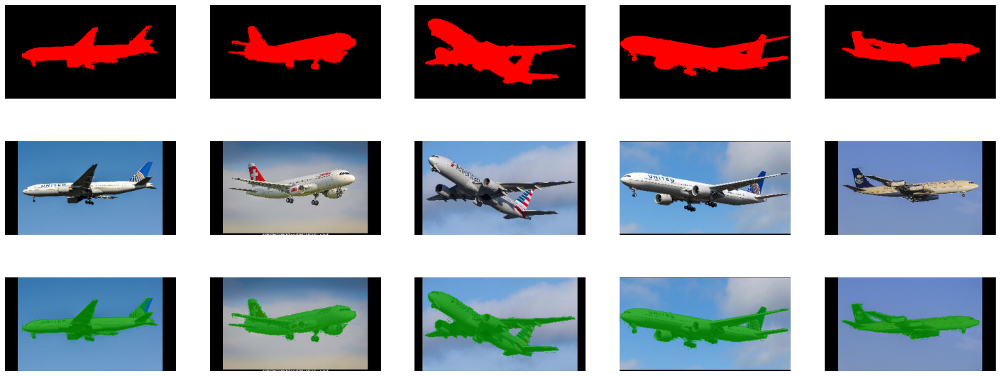

In [ ]:
# Тестируем модель
терра_ии.тест_модели_сегментации(
    нейронка_самолеты_3_2,
    тестовые_изображения = тестовая_выборка
)

### Модель на изображениях 520х960 


время формирования выборки: ~ 90мин; 

время обучения:~ 40мин

In [ ]:
# Загружаем базу самолетов
изображения_макс, сегментированные_изображения_макс = терра_ии.загрузить_базу(
    база = 'САМОЛЕТЫ_МАКС',
    справка = 'Показать'
)

Загрузка данных завершена 

url: https://storage.googleapis.com/terra_ai/DataSets/segment_max.zip
Вы скачали базу самолетов. 
База состоит из оригинальных изображений и соовтетствующих им размеченных сегментированных изображений.
Количество изображений в базе: 981
размер изображений (520х960 пикселей)


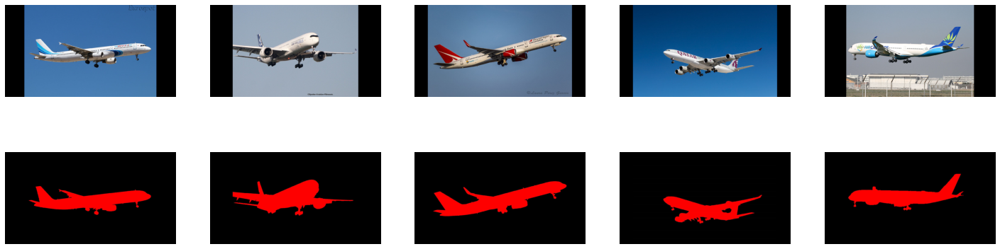

In [ ]:
# Отображаем примеры изображений
терра_ии.показать_примеры(
    оригиналы = изображения_макс,
    сегментированные_изображения = сегментированные_изображения_макс
)

In [ ]:
# Формируем данные для обучения
(обучающая_выборка_макс, размеченная_обучающая_выборка_макс), (тестовая_выборка_макс, размеченная_тестовая_выборка_макс) = терра_ии.создать_выборки_для_сегментации(
    изображения_макс, 
    сегментированные_изображения_макс
)


Данные загружены. Обработано: 981 изображений
Время обработки:  5231.63 c


In [ ]:
# Указываем слои для создаваемой модели
блок_вниз_1  =  'Сверточный2D-32-3 Сверточный2D-32-3'
блок_вниз_2  =  'Сверточный2D-64-3 Сверточный2D-64-3'
блок_вниз_3  =  'Сверточный2D-128-3 Сверточный2D-128-3'

блок_внизу   =  'Сверточный2D-256-3 Сверточный2D-256-3'

блок_вверх_1 =  'Объединение Сверточный2D-128-3 Сверточный2D-128-3'
блок_вверх_2 =  'Объединение Сверточный2D-64-3 Сверточный2D-64-3'
блок_вверх_3 =  'Объединение Сверточный2D-32-3 Сверточный2D-32-3'

# Получаем размер входных данных
входной_размер = терра_ии.получить_входной_размер(обучающая_выборка_макс)
# Создаем модель
нейронка_самолеты_макс = терра_ии.создать_UNET(
    блоки_вниз = [блок_вниз_1, блок_вниз_2, блок_вниз_3],
    блок_внизу = блок_внизу, 
    блоки_вверх = [блок_вверх_1, блок_вверх_2, блок_вверх_3],    
    входной_размер = входной_размер
)

Создана модель нейронной сети!


Схема модели:


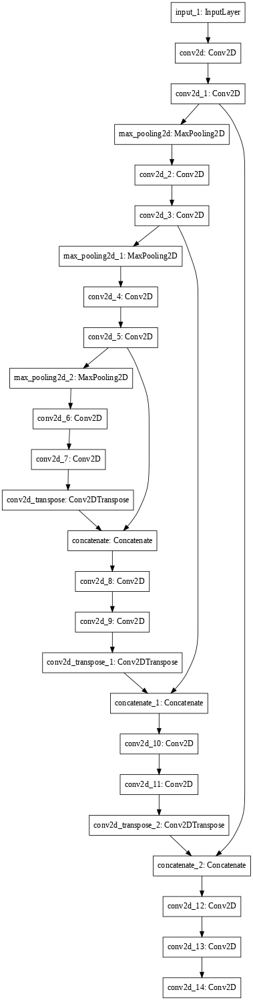

In [ ]:
# Выводим структуру модели
терра_ии.схема_модели(нейронка_самолеты_макс)

Эпоха №1    Время обучения: 71.32c  Точность на обучающей выборке: 84.92%    Точность на проверочной выборке: 87.81%
Эпоха №2    Время обучения: 43.13c  Точность на обучающей выборке: 87.78%    Точность на проверочной выборке: 90.21%
Эпоха №3    Время обучения: 43.1c   Точность на обучающей выборке: 90.21%    Точность на проверочной выборке: 94.27%
Эпоха №4    Время обучения: 43.1c   Точность на обучающей выборке: 93.23%    Точность на проверочной выборке: 95.42%
Эпоха №5    Время обучения: 43.09c  Точность на обучающей выборке: 95.84%    Точность на проверочной выборке: 95.71%
Эпоха №6    Время обучения: 43.07c  Точность на обучающей выборке: 96.44%    Точность на проверочной выборке: 96.87%
Эпоха №7    Время обучения: 43.08c  Точность на обучающей выборке: 97.09%    Точность на проверочной выборке: 97.32%
Эпоха №8    Время обучения: 43.01c  Точность на обучающей выборке: 97.09%    Точность на проверочной выборке: 97.04%
Эпоха №9    Время обучения: 43.04c  Точность на обучающей выборк

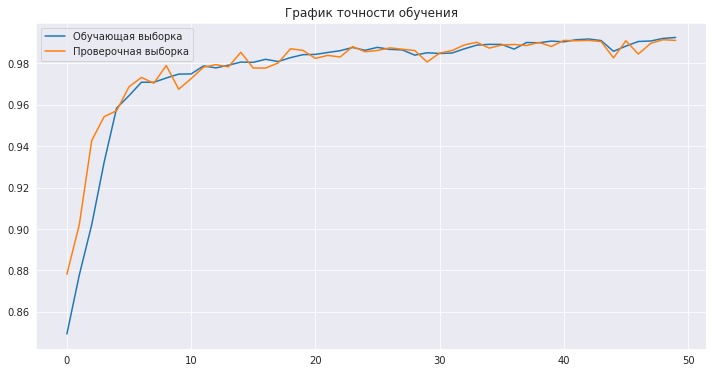

In [ ]:
# Обучаем модель
эксперимент_макс = терра_ии.обучение_модели(
    нейронка_самолеты_макс,
    обучающая_выборка_макс, размеченная_обучающая_выборка_макс,
    тестовая_выборка_макс, размеченная_тестовая_выборка_макс,
    размер_пакета = 8,
    количество_эпох = 55)

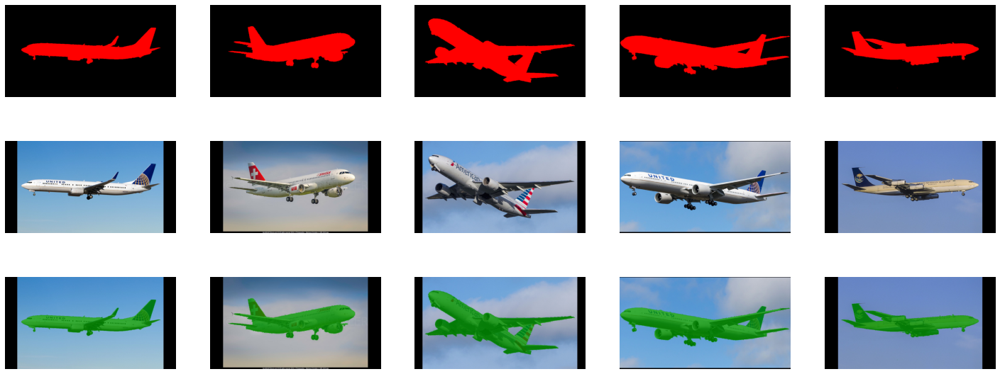

In [ ]:
# Тестируем модель
терра_ии.тест_модели_сегментации(
    нейронка_самолеты_макс,
    тестовые_изображения = тестовая_выборка_макс
)

### Сегментация людей

#### Подготовка данных

In [ ]:
# Загружаем базу изображений людей
изображения, сегментированные_изображения = терра_ии.загрузить_базу(
    база = 'ЛЮДИ', 
    справка = 'Показать'
)

Загрузка данных завершена 

url: https://storage.googleapis.com/terra_ai/DataSets/segment_people.zip
Вы скачали базу на которой изображены люди. 
База состоит из оригинальных изображений и соовтетствующих им размеченных сегментированных изображений.
Количество изображений в базе:  1021


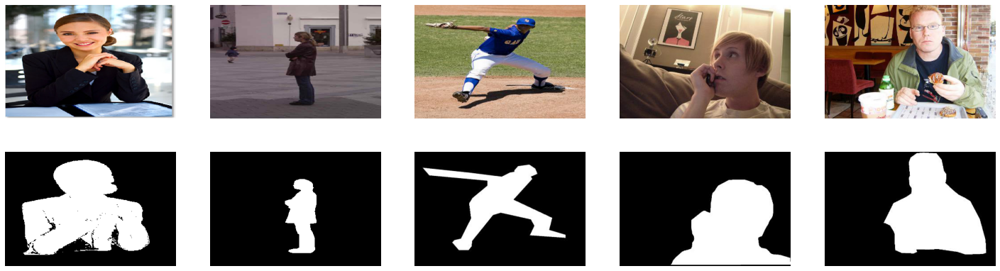

In [ ]:
# Отображаем примеры изображений
терра_ии.показать_примеры(
    оригиналы = изображения,
    сегментированные_изображения = сегментированные_изображения
)

In [ ]:
# Формируем данные для обучения
(обучающая_выборка, размеченная_обучающая_выборка), (тестовая_выборка, размеченная_тестовая_выборка) = терра_ии.создать_выборки_для_сегментации(
    изображения, 
    сегментированные_изображения
)


Данные загружены. Обработано: 1021 изображений
Время обработки:  1036.75 c


#### Исследования

###### Эксперимент №1.1 
Модель: простая линейная сеть 

In [ ]:
# Указываем слои создаваемой модели
слои = 'Сверточный2D-32-3\
 Сверточный2D-32-3\
 Сверточный2D-2-3' 

# Получаем входной размер данных
входной_размер = терра_ии.получить_входной_размер(обучающая_выборка)

# Создаем модель
нейронка_люди_1 = терра_ии.создать_сеть(
    слои = слои,
    входной_размер = входной_размер,
    задача='сегментация изображений'
    )

Создана модель нейронной сети!


Схема модели:


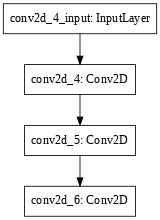

In [ ]:
терра_ии.схема_модели(нейронка_люди_1)

Эпоха №1    Время обучения: 19.16c  Точность на обучающей выборке: 63.66%    Точность на проверочной выборке: 35.58%
Эпоха №2    Время обучения: 1.7c    Точность на обучающей выборке: 64.0%     Точность на проверочной выборке: 66.65%
Эпоха №3    Время обучения: 1.71c   Точность на обучающей выборке: 68.03%    Точность на проверочной выборке: 72.26%
Эпоха №4    Время обучения: 1.71c   Точность на обучающей выборке: 68.53%    Точность на проверочной выборке: 63.24%
Эпоха №5    Время обучения: 1.72c   Точность на обучающей выборке: 67.41%    Точность на проверочной выборке: 67.58%
Эпоха №6    Время обучения: 1.72c   Точность на обучающей выборке: 67.37%    Точность на проверочной выборке: 69.34%
Эпоха №7    Время обучения: 1.7c    Точность на обучающей выборке: 67.81%    Точность на проверочной выборке: 67.34%
Эпоха №8    Время обучения: 1.72c   Точность на обучающей выборке: 67.77%    Точность на проверочной выборке: 62.67%
Эпоха №9    Время обучения: 1.7c    Точность на обучающей выборк

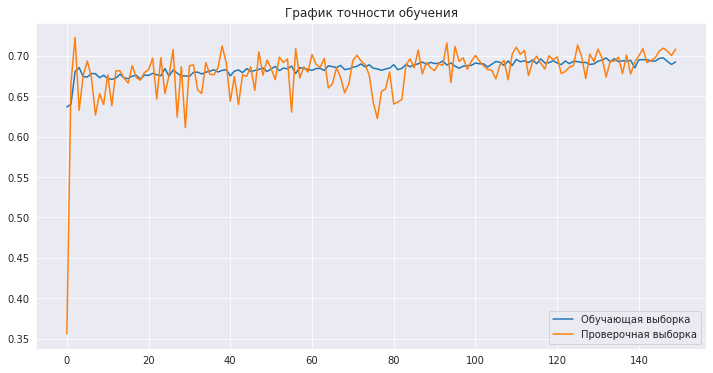

In [ ]:
# Обучаем модель
эксперимент_1_1 = терра_ии.обучение_модели(
    нейронка_люди_1,
    обучающая_выборка, размеченная_обучающая_выборка,
    тестовая_выборка, размеченная_тестовая_выборка,
    размер_пакета = 64,
    количество_эпох = 150)

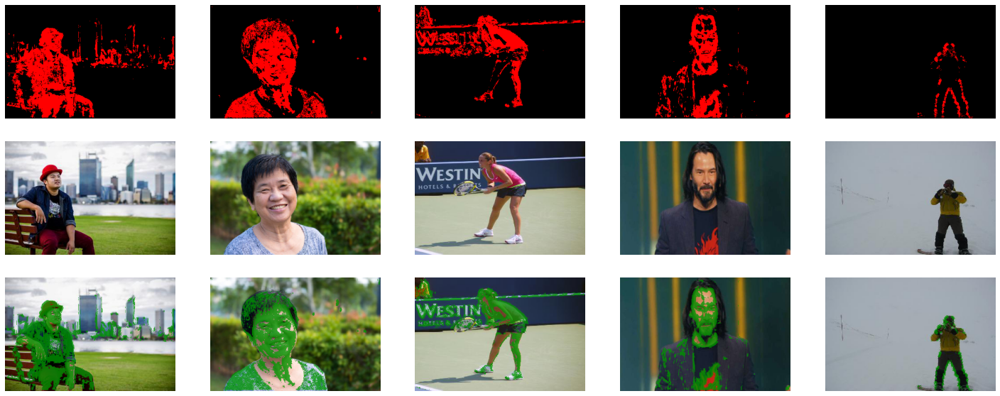

In [ ]:
# Тестируем работу модели
терра_ии.тест_модели_сегментации(
    нейронка_люди_1,
    тестовые_изображения = тестовая_выборка
)

###### Эксперимент №2.1
Модель: PSP-NET

In [ ]:
# Указываем слои создаваемой модели
стартовый_блок = 'Сверточный2D-32-3\
 Сверточный2D-32-3'

блок_PSP = 'Сверточный2D-32-3'

финальный_блок = 'Сверточный2D-32-3\
 Сверточный2D-32-3\
 Сверточный2D-2-3'

# Получаем размер входных данных
входной_размер = терра_ии.получить_входной_размер(обучающая_выборка)

# Создаем модель
нейронка_люди_2 = терра_ии.создать_PSP(
    стартовый_блок = стартовый_блок,
    блок_PSP = блок_PSP, 
    финальный_блок = финальный_блок,    
    входной_размер = входной_размер,
    количество_блоков = 2
)

Создана модель нейронной сети!


Схема модели:


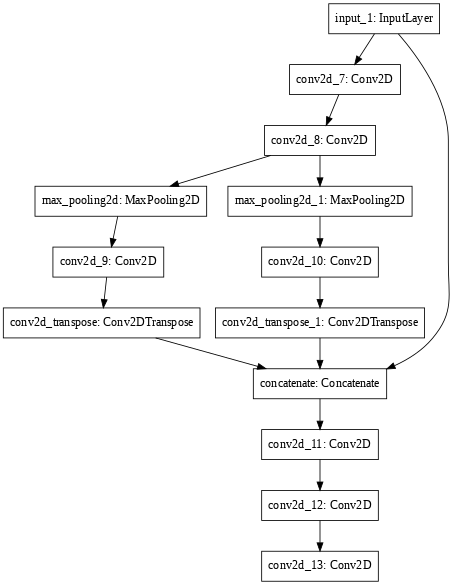

In [ ]:
# Выводим структуру модели
терра_ии.схема_модели(нейронка_люди_2)

Эпоха №1    Время обучения: 7.51c   Точность на обучающей выборке: 64.09%    Точность на проверочной выборке: 68.74%
Эпоха №2    Время обучения: 4.17c   Точность на обучающей выборке: 66.73%    Точность на проверочной выборке: 70.48%
Эпоха №3    Время обучения: 4.17c   Точность на обучающей выборке: 66.73%    Точность на проверочной выборке: 70.57%
Эпоха №4    Время обучения: 4.17c   Точность на обучающей выборке: 67.2%     Точность на проверочной выборке: 70.07%
Эпоха №5    Время обучения: 4.17c   Точность на обучающей выборке: 67.81%    Точность на проверочной выборке: 68.82%
Эпоха №6    Время обучения: 4.18c   Точность на обучающей выборке: 67.89%    Точность на проверочной выборке: 69.14%
Эпоха №7    Время обучения: 4.16c   Точность на обучающей выборке: 68.43%    Точность на проверочной выборке: 64.75%
Эпоха №8    Время обучения: 4.17c   Точность на обучающей выборке: 68.07%    Точность на проверочной выборке: 72.32%
Эпоха №9    Время обучения: 4.17c   Точность на обучающей выборк

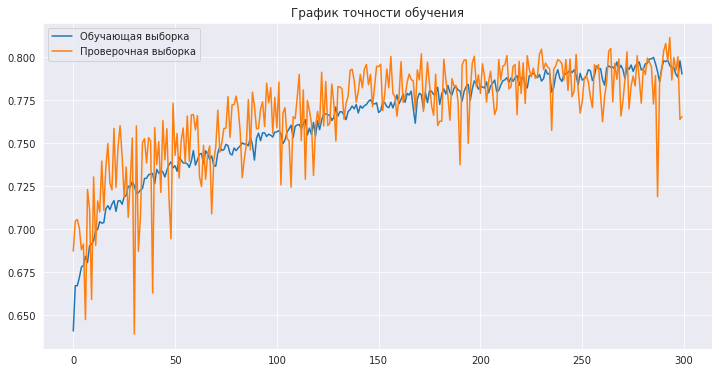

In [ ]:
# Обучаем модель
эксперимент_2_1 = терра_ии.обучение_модели(
    нейронка_люди_2,
    обучающая_выборка, размеченная_обучающая_выборка,
    тестовая_выборка, размеченная_тестовая_выборка,
    размер_пакета = 32,
    количество_эпох = 300)

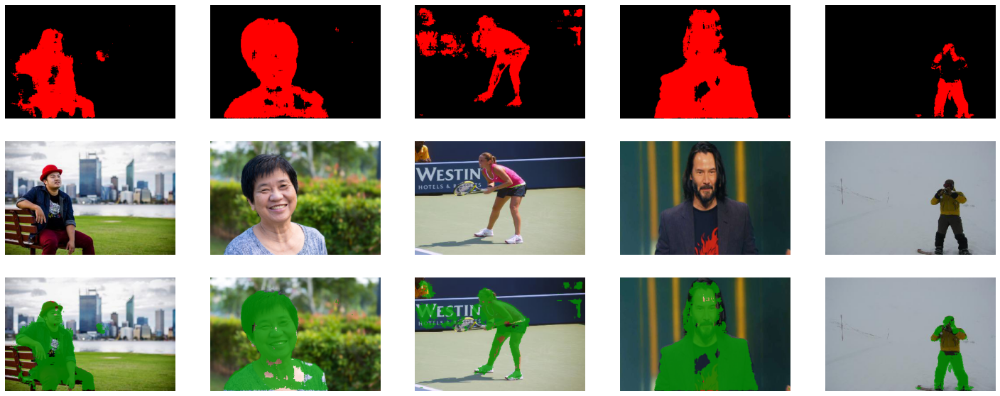

In [ ]:
# Тестируем модель
терра_ии.тест_модели_сегментации(
    нейронка_люди_2,
    тестовые_изображения = тестовая_выборка
)

###### Эксперимент № 2.2
Модель: PSP-NET

In [ ]:
# Создаем слои для создаваемой модели
стартовый_блок = 'Сверточный2D-64-2\
 Сверточный2D-64-2'

блок_PSP = 'Сверточный2D-64-2'

финальный_блок = 'Сверточный2D-64-2\
 Сверточный2D-64-2\
 Сверточный2D-2-2'

# Получаем размер входных данных
входной_размер = терра_ии.получить_входной_размер(обучающая_выборка)

# Создаем модель
нейронка_люди_2_2 = терра_ии.создать_PSP(
    стартовый_блок = стартовый_блок,
    блок_PSP = блок_PSP, 
    финальный_блок = финальный_блок,    
    входной_размер = входной_размер,
    количество_блоков = 4
)

Создана модель нейронной сети!


Схема модели:


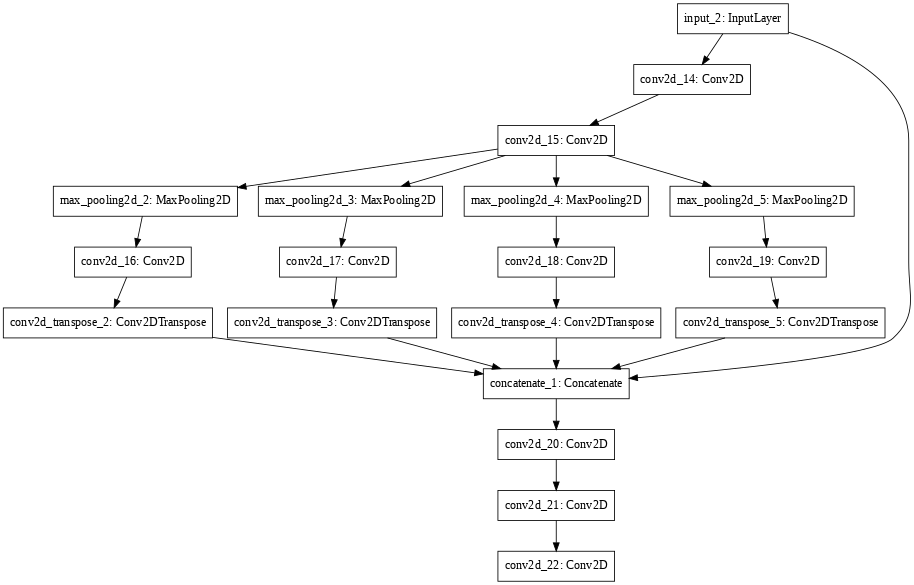

In [ ]:
# Выводим структуру модели
терра_ии.схема_модели(нейронка_люди_2_2)

Эпоха №1    Время обучения: 13.45c  Точность на обучающей выборке: 66.36%    Точность на проверочной выборке: 71.11%
Эпоха №2    Время обучения: 10.41c  Точность на обучающей выборке: 68.09%    Точность на проверочной выборке: 70.83%
Эпоха №3    Время обучения: 10.41c  Точность на обучающей выборке: 69.41%    Точность на проверочной выборке: 71.91%
Эпоха №4    Время обучения: 10.39c  Точность на обучающей выборке: 70.46%    Точность на проверочной выборке: 73.62%
Эпоха №5    Время обучения: 10.38c  Точность на обучающей выборке: 70.88%    Точность на проверочной выборке: 74.36%
Эпоха №6    Время обучения: 10.38c  Точность на обучающей выборке: 71.46%    Точность на проверочной выборке: 74.39%
Эпоха №7    Время обучения: 10.4c   Точность на обучающей выборке: 72.15%    Точность на проверочной выборке: 73.84%
Эпоха №8    Время обучения: 10.41c  Точность на обучающей выборке: 72.4%     Точность на проверочной выборке: 72.14%
Эпоха №9    Время обучения: 10.37c  Точность на обучающей выборк

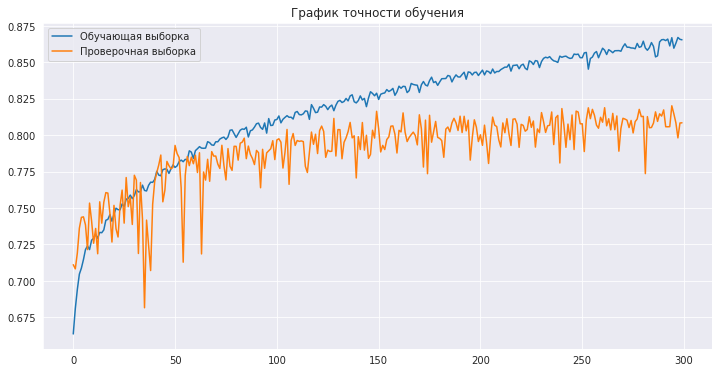

In [ ]:
# Обучаем модель
эксперимент_2_2 = терра_ии.обучение_модели(
    нейронка_люди_2_2,
    обучающая_выборка, размеченная_обучающая_выборка,
    тестовая_выборка, размеченная_тестовая_выборка,
    размер_пакета = 8,
    количество_эпох= 300)

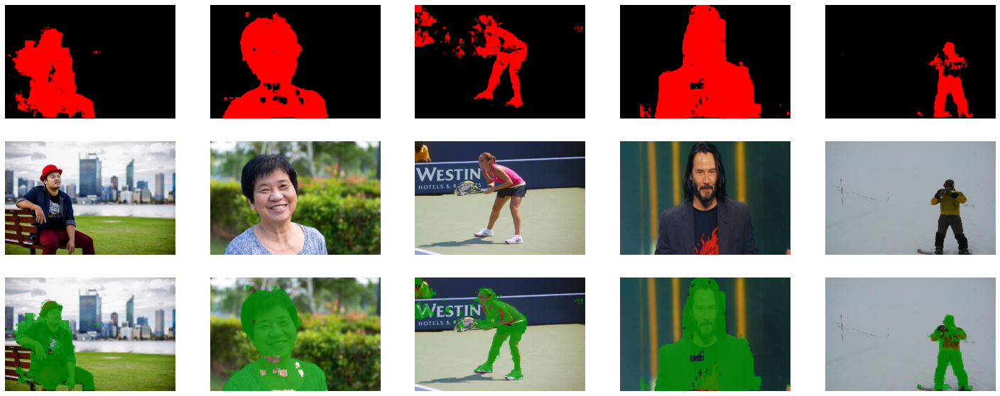

In [ ]:
# Тестируем модель
терра_ии.тест_модели_сегментации(
    нейронка_люди_2_2,
    тестовые_изображения = тестовая_выборка
)

###### Эксперимент №3.1
Модель: U-net

In [ ]:
# Указываем слои создаваемой модели
блок_вниз_1  =  'Сверточный2D-32-3 Сверточный2D-32-3'
блок_вниз_2  =  'Сверточный2D-64-3 Сверточный2D-64-3'

блок_внизу   =  'Сверточный2D-128-3 Сверточный2D-128-3'

блок_вверх_1 =  'Объединение Сверточный2D-64-3 Сверточный2D-64-3'
блок_вверх_2 =  'Объединение Сверточный2D-32-3 Сверточный2D-32-3'

# Выводим размер входных данных
входной_размер = терра_ии.получить_входной_размер(обучающая_выборка)

# Создаем модель
нейронка_люди_3 = терра_ии.создать_UNET(
    блоки_вниз = [блок_вниз_1, блок_вниз_2],
    блок_внизу = блок_внизу, 
    блоки_вверх = [блок_вверх_1, блок_вверх_2],    
    входной_размер = входной_размер
)

Создана модель нейронной сети!


Схема модели:


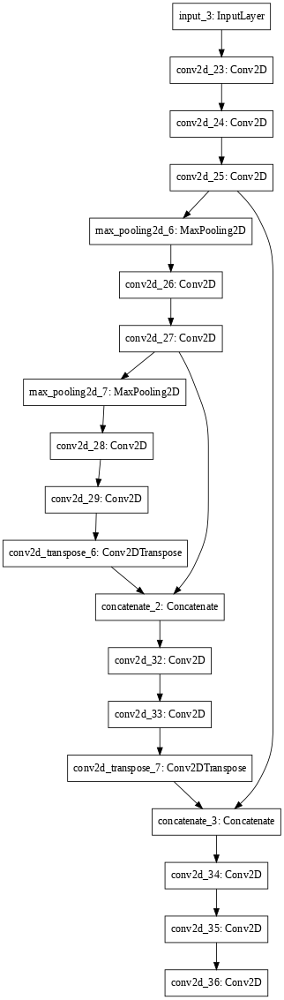

In [ ]:
# Выводим структуру модели
терра_ии.схема_модели(нейронка_люди_3)

Эпоха №1    Время обучения: 9.76c   Точность на обучающей выборке: 63.56%    Точность на проверочной выборке: 64.6%
Эпоха №2    Время обучения: 6.41c   Точность на обучающей выборке: 65.06%    Точность на проверочной выборке: 68.18%
Эпоха №3    Время обучения: 6.4c    Точность на обучающей выборке: 67.66%    Точность на проверочной выборке: 70.26%
Эпоха №4    Время обучения: 6.43c   Точность на обучающей выборке: 70.72%    Точность на проверочной выборке: 74.52%
Эпоха №5    Время обучения: 6.38c   Точность на обучающей выборке: 70.58%    Точность на проверочной выборке: 69.92%
Эпоха №6    Время обучения: 6.42c   Точность на обучающей выборке: 72.15%    Точность на проверочной выборке: 75.92%
Эпоха №7    Время обучения: 6.45c   Точность на обучающей выборке: 73.9%     Точность на проверочной выборке: 75.08%
Эпоха №8    Время обучения: 6.38c   Точность на обучающей выборке: 74.04%    Точность на проверочной выборке: 72.04%
Эпоха №9    Время обучения: 6.37c   Точность на обучающей выборке

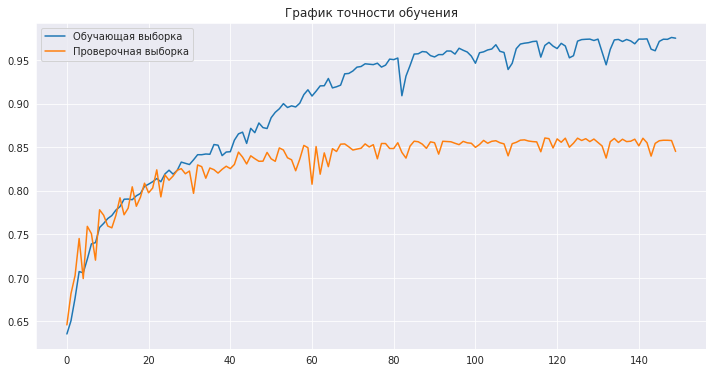

In [ ]:
# Обучаем модель
эксперимент_3_1 = терра_ии.обучение_модели(
    нейронка_люди_3,
    обучающая_выборка, размеченная_обучающая_выборка,
    тестовая_выборка, размеченная_тестовая_выборка,
    размер_пакета = 8,
    количество_эпох = 150)

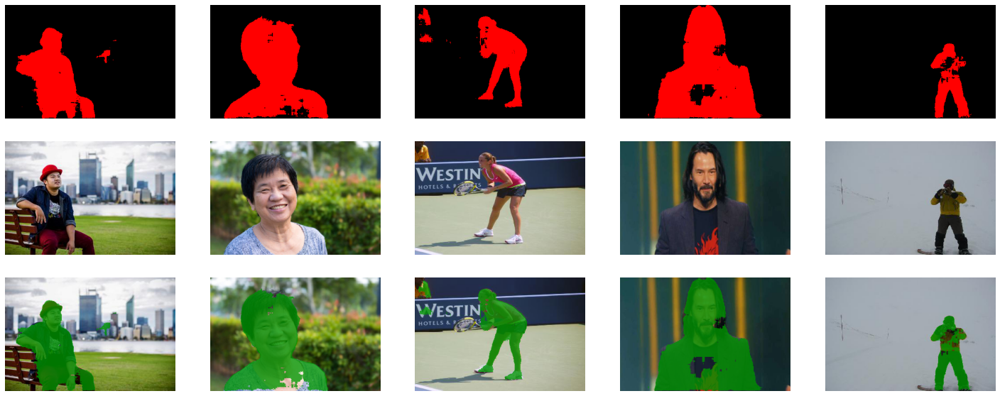

In [ ]:
# Тестируем модель
терра_ии.тест_модели_сегментации(
    нейронка_люди_3,
    тестовые_изображения = тестовая_выборка
)

###### Эксперимент № 3.2 
Модель: U-Net (лучшая модель)


In [ ]:
# Указываем слои для создаваемой модели
блок_вниз_1  =  'Сверточный2D-32-3 Сверточный2D-32-3'
блок_вниз_2  =  'Сверточный2D-64-3 Сверточный2D-64-3'
блок_вниз_3  =  'Сверточный2D-128-3 Сверточный2D-128-3'

блок_внизу   =  'Сверточный2D-256-3 Сверточный2D-256-3'

блок_вверх_1 =  'Объединение Сверточный2D-128-3 Сверточный2D-128-3'
блок_вверх_2 =  'Объединение Сверточный2D-64-3 Сверточный2D-64-3'
блок_вверх_3 =  'Объединение Сверточный2D-32-3 Сверточный2D-32-3'

# Получаем размер входных данных
входной_размер = терра_ии.получить_входной_размер(обучающая_выборка)
# Создаем модель
нейронка_люди_3_2 = терра_ии.создать_UNET(
    блоки_вниз = [блок_вниз_1, блок_вниз_2, блок_вниз_3],
    блок_внизу = блок_внизу, 
    блоки_вверх = [блок_вверх_1, блок_вверх_2, блок_вверх_3],    
    входной_размер = входной_размер
)

Создана модель нейронной сети!


Схема модели:


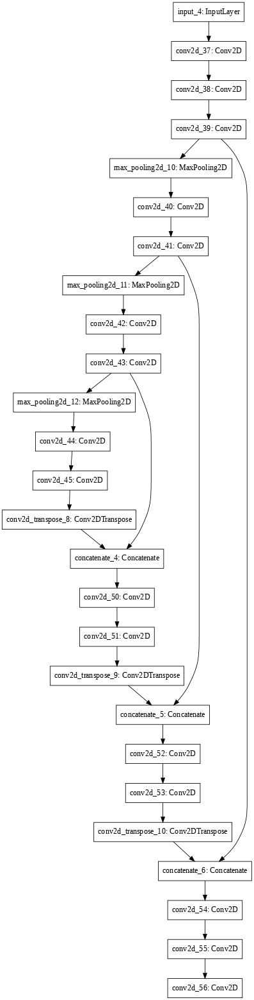

In [ ]:
# Выводим структуру модели
терра_ии.схема_модели(нейронка_люди_3_2)

Эпоха №1    Время обучения: 12.71c  Точность на обучающей выборке: 63.66%    Точность на проверочной выборке: 67.61%
Эпоха №2    Время обучения: 8.99c   Точность на обучающей выборке: 66.39%    Точность на проверочной выборке: 74.1%
Эпоха №3    Время обучения: 9.04c   Точность на обучающей выборке: 69.92%    Точность на проверочной выборке: 72.27%
Эпоха №4    Время обучения: 8.99c   Точность на обучающей выборке: 73.01%    Точность на проверочной выборке: 67.41%
Эпоха №5    Время обучения: 9.04c   Точность на обучающей выборке: 73.01%    Точность на проверочной выборке: 77.44%
Эпоха №6    Время обучения: 9.03c   Точность на обучающей выборке: 76.1%     Точность на проверочной выборке: 75.71%
Эпоха №7    Время обучения: 9.05c   Точность на обучающей выборке: 77.09%    Точность на проверочной выборке: 77.75%
Эпоха №8    Время обучения: 8.99c   Точность на обучающей выборке: 77.03%    Точность на проверочной выборке: 78.08%
Эпоха №9    Время обучения: 9.04c   Точность на обучающей выборке

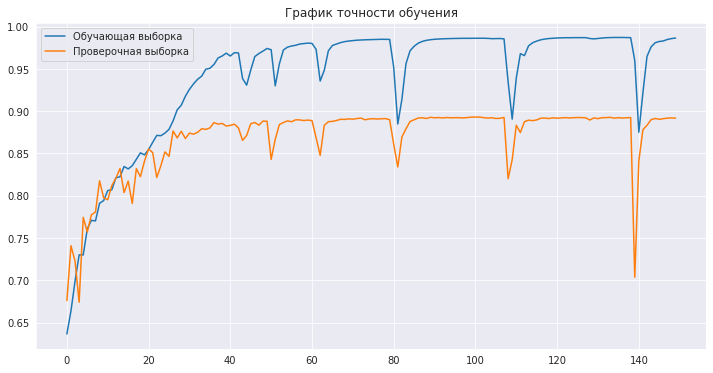

In [ ]:
# Обучаем модель
эксперимент_3_2 = терра_ии.обучение_модели(
    нейронка_люди_3_2,
    обучающая_выборка, размеченная_обучающая_выборка,
    тестовая_выборка, размеченная_тестовая_выборка,
    размер_пакета = 8,
    количество_эпох = 150)

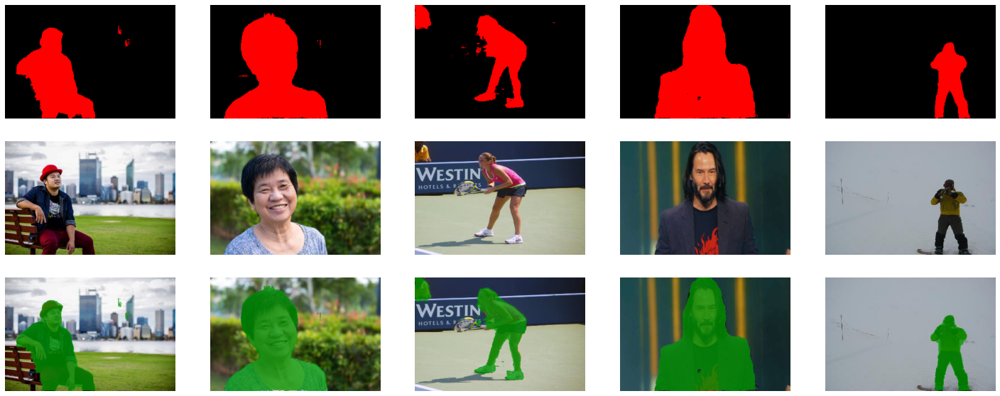

In [ ]:
# Тестируем модель
терра_ии.тест_модели_сегментации(
    нейронка_люди_3_2,
    тестовые_изображения = тестовая_выборка)

## Распознавание голосовых команд для умного дома.

In [ ]:
# Загружаем базу голосовых команд УМНЫЙ ДОМ
терра_ии.загрузить_базу('УМНЫЙ ДОМ', 
                    справка = 'Показать')

Загрузка данных завершена 

url: https://storage.googleapis.com/terra_ai/DataSets/cHome.zip
Загружена база голосовых команд для умного дома



Пример голосовой команды «Кондиционер»:


Спектр голосовой команды:


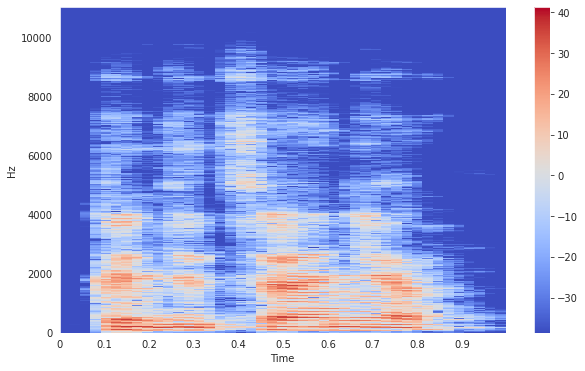

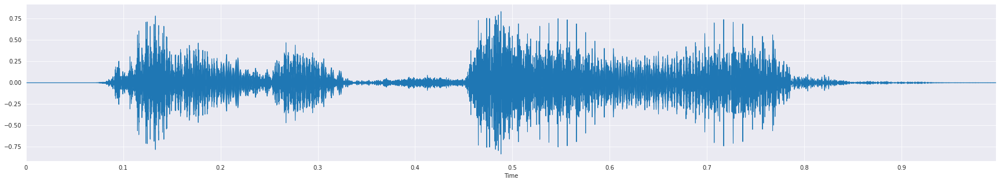



Пример голосовой команды «Свет»:


Спектр голосовой команды:


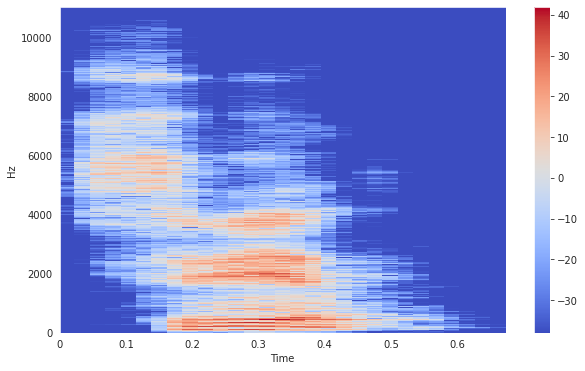

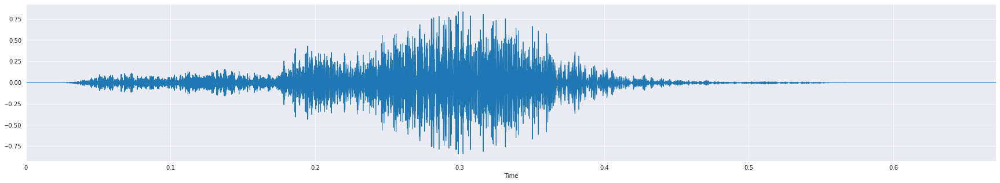



Пример голосовой команды «Телевизор»:


Спектр голосовой команды:


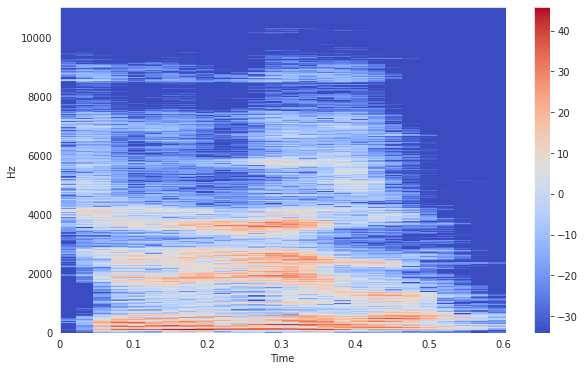

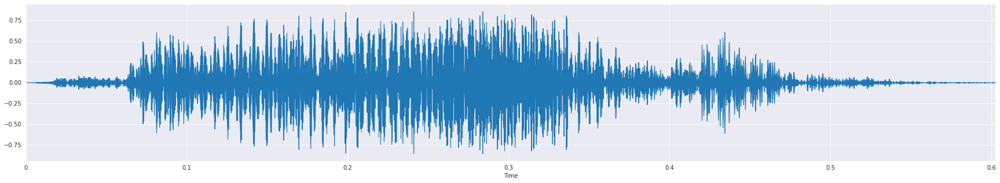



Пример голосовой команды «Фон»:


Спектр голосовой команды:


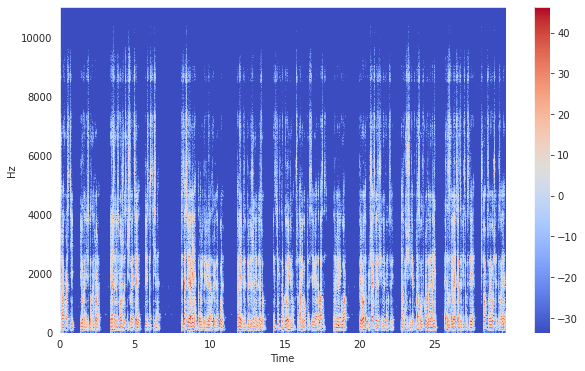

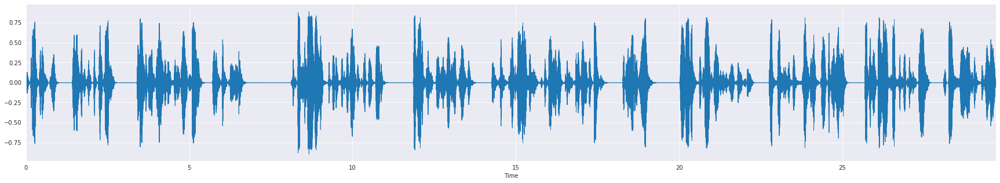

In [ ]:
терра_ии.показать_примеры_голосовых_команд()

Команда: кондиционер
Исходное аудио: 


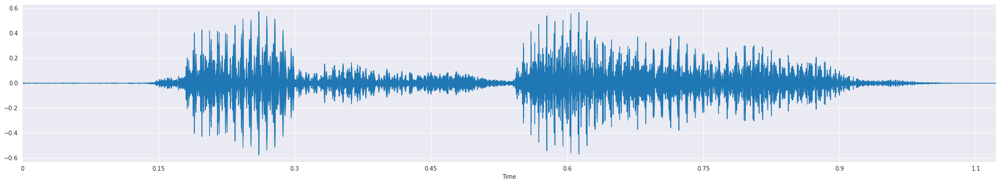



Спектр сигнала:


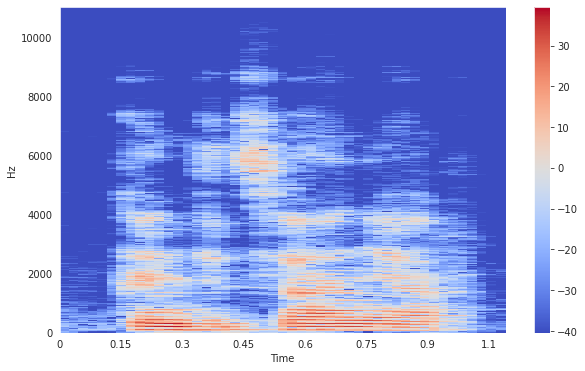

In [ ]:
# Показать пример параметризации аудио-файла 
# Параметр файл может принимать одно из значений: кондиционер, свет, телевизор, фон
терра_ии.параметризация_аудио(
    файл = 'кондиционер'
)

In [ ]:
# Создаем обучающую и проверочную выборки
длина = 0.5 # Задаем длину аудио_отрезка при формировании выборки
шаг = 0.04 # Задаем шаг при формировании выборки
(обучающая_выборка, метки_обучающей_выборки), (тестовая_выборка, метки_тестовой_выборки) = терра_ии.создать_выборки_голосовых_команд(длина, шаг)



Данные успешно загружены. Обработано: 362 аудио

Время обработки: 4 мин 40.41 c


In [ ]:
# Указываем слои содаваемой модели
слои = 'Сверточный2D-8-2 Выравнивающий Полносвязный-128 Полносвязный-64 Полносвязный-4'

# Получаем размер входных данных
входной_размер = терра_ии.получить_входной_размер(обучающая_выборка)

# Создаем модель
нейронка_аудио_1 = терра_ии.создать_сеть(
    слои = слои,
    входной_размер = входной_размер,
    задача='аудио'
    )

Создана модель нейронной сети!


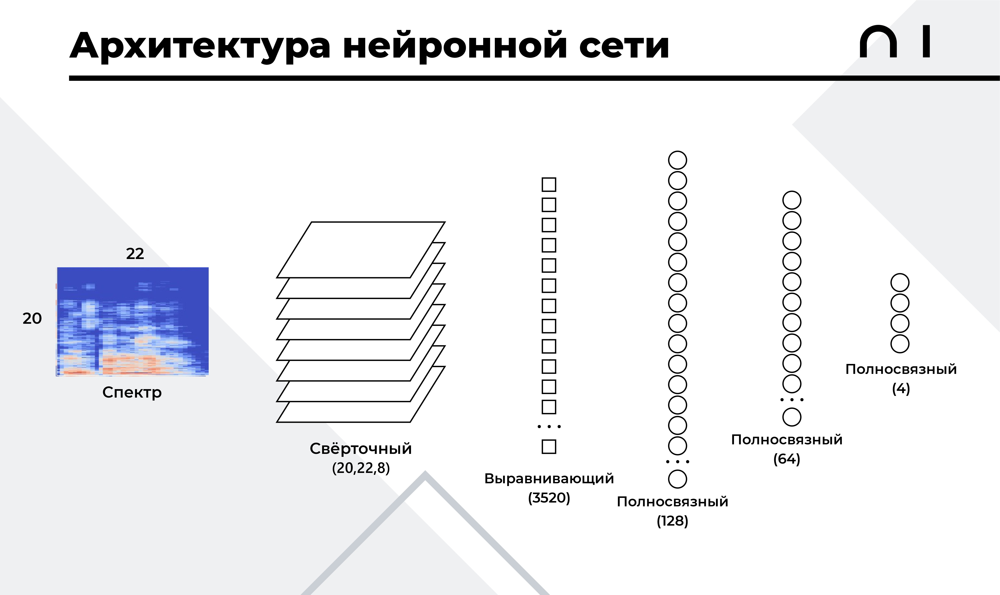

Схема модели:


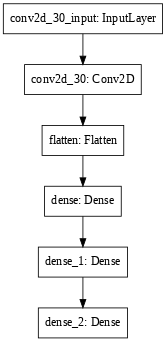

In [ ]:
# Выводим структуру модели
терра_ии.схема_модели(нейронка_аудио_1)

Эпоха №1  Время обучения: 1.27c  Точность на обучающей выборке: 96.82%       Точность на проверочной выборке: 98.91%
Эпоха №2  Время обучения: 0.67c  Точность на обучающей выборке: 99.08%       Точность на проверочной выборке: 99.23%
Эпоха №3  Время обучения: 0.68c  Точность на обучающей выборке: 99.31%       Точность на проверочной выборке: 99.58%
Эпоха №4  Время обучения: 0.67c  Точность на обучающей выборке: 99.82%       Точность на проверочной выборке: 99.75%
Эпоха №5  Время обучения: 0.66c  Точность на обучающей выборке: 99.91%       Точность на проверочной выборке: 99.9%
Эпоха №6  Время обучения: 0.66c  Точность на обучающей выборке: 99.88%       Точность на проверочной выборке: 99.77%
Эпоха №7  Время обучения: 0.68c  Точность на обучающей выборке: 99.58%       Точность на проверочной выборке: 99.58%
Эпоха №8  Время обучения: 0.66c  Точность на обучающей выборке: 99.63%       Точность на проверочной выборке: 99.39%
Эпоха №9  Время обучения: 0.66c  Точность на обучающей выборке: 9

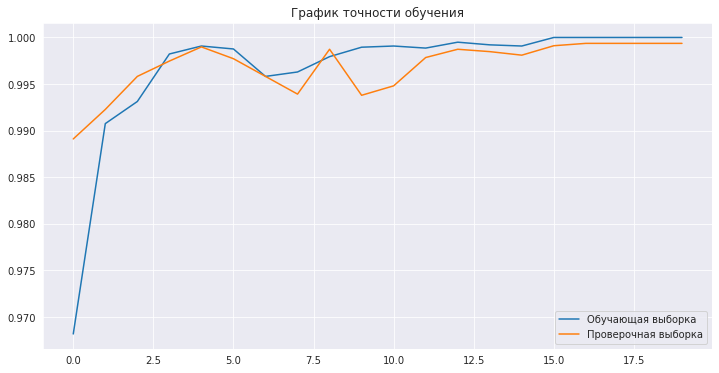

In [ ]:
# Обучаем модель
эксперимент_1 = терра_ии.обучение_модели(
    нейронка_аудио_1,
    обучающая_выборка, метки_обучающей_выборки,
    тестовая_выборка, метки_тестовой_выборки,
    размер_пакета = 128,
    количество_эпох = 20)

### Тестирование модели

Исходное аудио для проверки работы нейронной сети: 



Распознана команда: " КОНДИЦИОНЕР " (вероятность - 99.91 %)


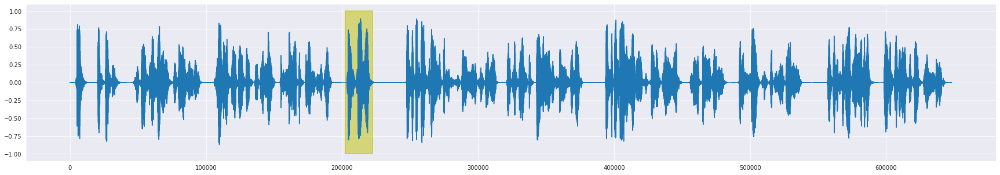

In [ ]:
# Тестируем модель
терра_ии.тест_модели_голосовых_команд(нейронка_аудио_1, порог=0.95, длина=длина, шаг=шаг)

Исходное аудио для проверки работы нейронной сети: 



Распознана команда: " СВЕТ " (вероятность - 99.88 %)


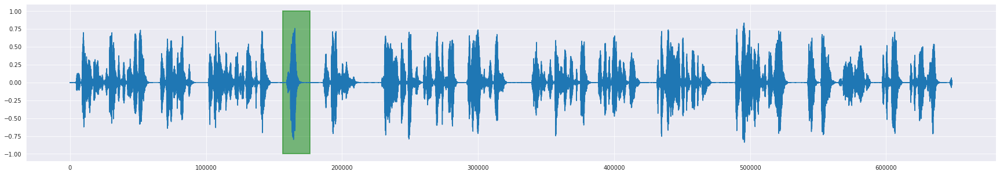

In [ ]:
терра_ии.тест_модели_голосовых_команд(нейронка_аудио_1, порог=0.95, длина=длина, шаг=шаг)

Исходное аудио для проверки работы нейронной сети: 



Распознана команда: " ТЕЛЕВИЗОР " (вероятность - 99.73 %)


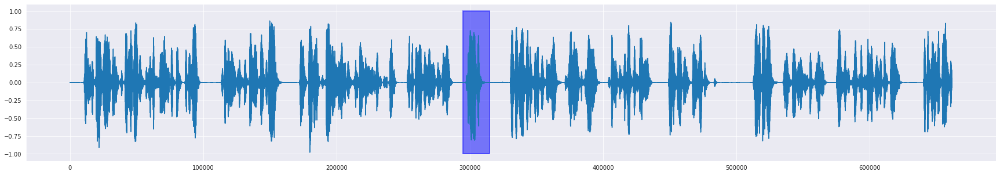

In [ ]:
терра_ии.тест_модели_голосовых_команд(нейронка_аудио_1, порог=0.95, длина=длина, шаг=шаг)

# **Домашнее задание**

In [ ]:
!pip -q install terra_ai
from terra_ai import терра_ии

Все необходимые библиотеки установлены и готовы к работе


## Задание № 1. Распознавание голосовых команд для умного дома.



Создайте нейросеть, которая будет распознавать голосовые команды из базы 'УМНЫЙ ДОМ':

1. Загрузите базу
2. Покажите примеры голосовых команд из загруженной базы
3. Создайте выборки
4. Создайте слои модели.
5. Продемонстируйте схему созданной модели
6. Обучите свою модель
7. Проведите тестирование

In [ ]:
# Загружаем базу аудиозаписей для умного дома
терра_ии.загрузить_базу(???, справка='показать')

In [ ]:
терра_ии.показать_примеры_голосовых_команд()

In [ ]:
# Показать пример параметризации аудио-файла 
# Параметр файл может принимать одно из значений: кондиционер, свет, телевизор, фон
терра_ии.параметризация_аудио(
    файл = ''
)

In [ ]:
# Создаем обучающую и проверочную выборки
длина = 0.5 # Задаем длину аудио_отрезка при формировании выборки
шаг = 0.04 # Задаем шаг при формировании выборки
(обучающая_выборка, метки_обучающей_выборки), (тестовая_выборка, метки_тестовой_выборки) = терра_ии.создать_выборки_голосовых_команд(длина, шаг)

 Создайте нейросеть, которая будет включать в себя следующие слои:


*   Сверточный2D
*   Выравнивающий
*   Полносвязный






In [ ]:
# Указываем слои создаваемой модели
слои = ''

# Получаем размер входных данных
входной_размер = терра_ии.получить_входной_размер(обучающая_выборка)

# Создаем модель
нейронка = терра_ии.создать_сеть(
    слои = слои,
    входной_размер = входной_размер,
    задача='аудио'
    )

Покажите структуру сети, с помощью функции терра_ии.схема_модели(внутри функции указывается нейросеть, которую вы создали)

In [ ]:
# Выводим структуру модели


Задайте параметры для обучения модели: 
1. Нейронка
2. Обучающая и проверочная выборки
3. Размер пакета
4. Количество эпох




In [ ]:
# Обучаем модель
терра_ии.обучение_модели(
    )

Протестируйте свою модель

In [ ]:
терра_ии.тест_модели_голосовых_команд(нейронка, порог=0.95, длина=длина, шаг=шаг)

## Задание № 2. Трейдинг с помощью нейронных сетей на базе Газпром.


Сделайте нейронную сеть для прогнозирования акций "Газпрома": 
1. Загрузите базу
2. Покажите примеры данных
3. Создайте выборки
4. Создайте слои модели
5. Продемонстируйте схему созданной модели
6. Обучите свою модель
7. Проведите тестирование

In [ ]:
# Загружаем базу ТРЕЙДИНГ
терра_ии.загрузить_базу('ТРЕЙДИНГ', справка='Показать')

In [ ]:
# Формируем обучающую и тестовые выборки
количество_анализируемых_дней=10
период_предсказания=1
(обучающая_выборка, метки_обучающей_выборки), (тестовая_выборка, метки_тестовой_выборки), данные  = терра_ии.создать_выборки_для_торговли(
    акции= '  ',
    количество_анализируемых_дней=количество_анализируемых_дней,
    период_предсказания=период_предсказания)

In [ ]:
# Посмотреть данные
терра_ии.показать_примеры_для_трейдинга(данные)

In [ ]:
терра_ии.показать_примеры_для_интервала(данные, 100, 200) # Укажите интервал, где первое число начало интервала, а второе число окончание 

Создайте нейронную сет, в которую будут входить слои, рассмотренные на вебинаре, такие как:

*   Сверточный1D
*   Выравнивающий
*   Полносвязный
*   МаксПуллинг1D







In [ ]:
# Указываем слои для создания модели
слои = ' '

# Получаем размер входных данных
входной_размер = терра_ии.получить_входной_размер(обучающая_выборка)

# Создаем модель
нейронка_1 = терра_ии.создать_сеть(
    слои = слои,
    входной_размер = входной_размер,
    задача = 'временной ряд'
    )

Покажите структуру сети, с помощью функции терра_ии.схема_модели(внутри функции указывается нейросеть, которую вы создали)

In [ ]:
# Выводим структуру модели
терра_ии.схема_модели()

Задайте параметры для обучения модели: 
1. Нейронка
2. Обучающая и проверочная выборки
3. Размер пакета
4. Количество эпох

In [ ]:
# Обучаем модель
терра_ии.обучение_модели(
    
)


Используя функцию из terra_ai терра_ии.тест_модели_торговли() протестируйте свою модель

In [ ]:
терра_ии.тест_модели_торговли(
    нейронка_1, 
    тестовая_выборка, метки_тестовой_выборки,
    данные,
    период_предсказания,
    количество_анализируемых_дней)

In [ ]:
терра_ии.примеры_распознавания(нейронка_1, 
          период_предсказания, 
          количество_анализируемых_дней)

In [ ]:
# для мгновенного вывода результата укажите значение параметра тип='результат'
терра_ии.торговля(нейронка_1, тестовая_выборка, данные, тип='процесс')

## Задание № 3. Сегментация губ

Напишите нейронную сеть, решающую задачу сегментации губ (можете использовать различные подходы для создания архитектуры)
1. Скачайте базу
2. Покажите примеры из загруженной базы
3. Создайте выборки
4. Создайте модель
5. Продемонстируйте схему созданной модели
6. Обучите свою модель
7. Проведите тестирование


In [ ]:
# Загружаем базу губ
изображения, сегментированные_изображения = терра_ии.загрузить_базу(
    база = 'ГУБЫ',
    справка = 'Показать'
)

In [ ]:
# Выводим примеры изображений
терра_ии.показать_примеры(
    оригиналы = изображения,
    сегментированные_изображения = сегментированные_изображения
)

In [ ]:
# Формируем данные для обучения
(обучающая_выборка, размеченная_обучающая_выборка), (тестовая_выборка, размеченная_тестовая_выборка) = терра_ии.создать_выборки_для_сегментации(
    изображения, 
    сегментированные_изображения
)

Создайте PSPnet 

*   Сверточный2D



In [ ]:
# Указываем слои создаваемой модели
стартовый_блок = ????

блок_PSP = ????

финальный_блок = ????

# Получаем входной размер данных
входной_размер = терра_ии.получить_входной_размер(обучающая_выборка)

# Создаем модель
нейронка = терра_ии.создать_PSP(
    стартовый_блок = ????,
    блок_PSP = ????, 
    финальный_блок = ????,    
    входной_размер = ????,
    количество_блоков = 2
)

Задайте параметры для обучения модели: 
1. Нейронка
2. Обучающая и проверочная выборки
3. Размер пакета
4. Количество эпох

In [ ]:
# Обучение модели
терра_ии.обучение_модели(
   )

Проведите тест модели

In [ ]:
# Тестирование модели
терра_ии.тест_модели_сегментации(
    нейронка,
    тестовые_изображения = тестовая_выборка)